# Name : Ubaid Ur Rehman
# Project : Class Attendance using AI
# Date: 23/03/2025
# Supervised by : Michel Riveill & Diane Lingrand


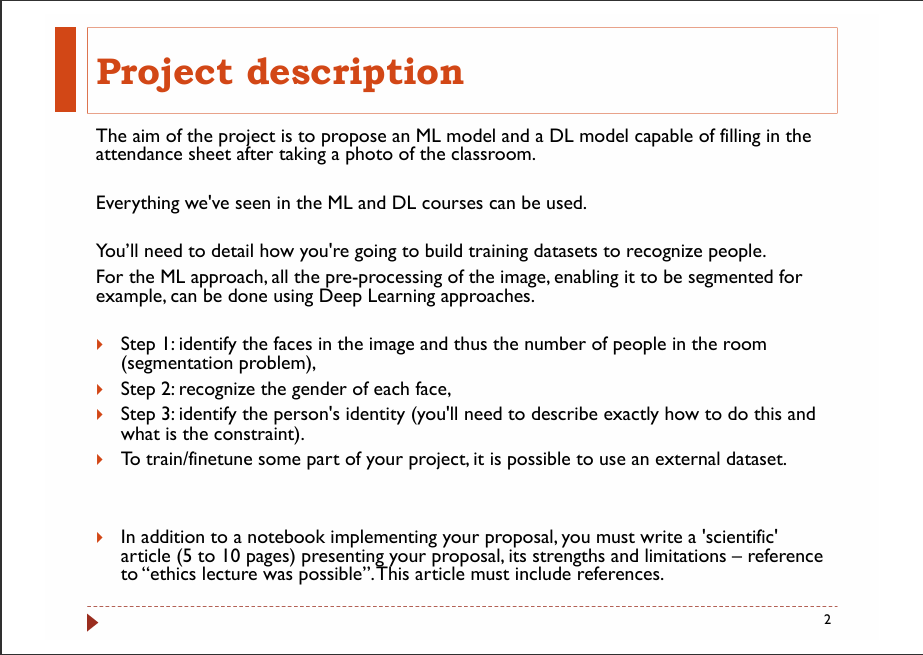

<h2>Introduction</h2>
<p>
    In this project, I developed a Machine and Deep Learning-based system for student attendance tracking. The task involved creating a dataset from student images or classroom videos, processing images using OpenCV, and training various models to recognize students. The key steps included:
</p>

<h2>Machine Learning</h2>
<h3>Steps</h3>
<ul>
    <li>Creating a dataset using student images or video.</li>
    <li>Using OpenCV's Haar Cascades for face and eye detection.</li>
    <li>Processing images to ensure sufficient data for modeling.</li>
    <li>Applying image transformations like zoom, flip, and crop.</li>
    <li>Using Wavelet Transform to extract facial features.</li>
    <li>Combining original cropped and wavelet-transformed images to form a 4096-feature vector.</li>
    <li>Training models like <b><span style="color:#FF5733;">SVM</span></b>, <b><span style="color:#33A2FF;">Random Forest</span></b>, and <b><span style="color:#28A745;">Logistic Regression</span></b>.</li>
</ul>

<h2>Deep Learning</h2>
<h3>Steps</h3>
<ul>
    <li>Creating a dataset using student images or videos.</li>
    <li>Using OpenCV's Haar Cascades and OpenCV for face and eye detection.</li>
    <li>Processing images by resizing and normalizing them for deep learning models.</li>
    <li>Applying image augmentations like zoom, flip, and crop to enhance model generalization.</li>
    <li>Training a <b><span style="color:#FFD700;">Simple CNN from Scratch</span></b> for baseline performance.</li>
    <li>Applying <b><span style="color:#FFD700;">Transfer Learning</span></b> using pre-trained models:
        <ul>
            <li><b><span style="color:#DC143C;">VGG16</span></b> → fit → save → predict <b>(we save attendance sheet for this model)</b></li>
            <li><b><span style="color:#8A2BE2;">InceptionV3</span></b> → fit → save → predict</li>
            <li><b><span style="color:#FF8C00;">ResNet50</span></b> → fit → save → predict</li>
            <li><b><span style="color:#008080;">EfficientNetB0</span></b> → fit → save → predict</li>
        </ul>
    </li>
    <li>Evaluating models based on training & validation accuracy, loss, and performance metrics.</li>
</ul>

<h2>Gender Detection</h2>
<h3>Steps</h3>
<ul>
    <li>Getting a dataset of male and female images from <b>Kaggle</b>.</li>
    <li>Training a <b><span style="color:#FFD700;">Simple CNN </span></b> for baseline performance.</li>
    <li>Evaluating models based on training & validation accuracy, loss, and performance metrics.</li>
    <li>Getting results to classify faces' gender in class properly.</li>
</ul>

<h2>Ethical Considerations in AI for Attendance Systems</h2>

<h3>Bias in Data and Models</h3>
<ul>
    <li><b>Limited Dataset:</b> The dataset used for training is small, which may lead to poor generalization.</li>
    <li><b>Gender Representation Bias:</b> The class contains only three girls, leading to gender imbalance when detecting faces.</li>
    <li><b>External Data Usage:</b> For gender detection, a dataset from Kaggle was used, which may not reflect the real distribution of students in the class.</li>
    <li><b>Low Image Quality:</b> Cropped faces from classroom videos may not be clear, leading to inaccurate predictions.</li>
</ul>

<h3>Computational Constraints</h3>
<ul>
    <li><b>Resource Limitation:</b> Training deep learning models requires significant computational power.</li>
    <li><b>Low-Resolution Training:</b> Due to hardware limitations, training was limited to 128-pixel images. Higher resolutions could improve accuracy but are not feasible on the available system.</li>
</ul>

<h3>Ethical Concerns in AI-Based Attendance</h3>
<ul>
    <li><b>Privacy Issues:</b> Capturing images of students without consent raises ethical and legal concerns.</li>
    <li><b>Surveillance and Trust:</b> Continuous monitoring may lead to discomfort and trust issues among students.</li>
    <li><b>Fairness and Accuracy:</b> Incorrect face recognition can result in false absenteeism, impacting students unfairly.</li>
    <li><b>Algorithmic Bias:</b> The model may misclassify certain students due to biases in training data, leading to discrimination.</li>
</ul>

<h2>Constraints</h2>
<ul>
    <li>The dataset is not large enough for robust model training.</li>
    <li>Gender imbalance in the dataset may lead to inaccurate gender classification.</li>
    <li>Computational power limitations prevent training on high-resolution images.</li>
    <li>Cropped face images from videos are not always clear, affecting recognition accuracy.</li>
    <li>Ethical concerns about privacy and consent when using AI-based attendance systems.</li>
</ul>

<p>
    Below, I will explain each part of the process in detail.
</p>


In [ ]:
# import the necessary packages
import numpy as np
import cv2
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline


In this project i am going to use `Haar Cascades` Open CV library because after analyzing it. It was seems to easy fro me to use for image preprocessing like first task in this project using images.
1. How we get `face` from image 
2. After getting face then how to get `eyes` from face

# 1. Preprocessing: Detect face and eyes


When we look at any image, most of the time we identify a person using a face. An image might contain multiple faces, also the face can be obstructed and not clear. The first step in our pre-processing pipeline is to detect faces from an image. Once face is detected, we will detect eyes, if two eyes are detected then only we keep that image otherwise discard it.
Now how do you detect face and eyes?

We will use haar cascade from opencv for this. Here is an article on this: https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_objdetect/py_face_detection/py_face_detection.html?highlight=haar

## 1. 1. haar cascade on one image

### 1.1.1. Lets take my image then  we will see what will happens when we use this Haar Cascades Library 

In [ ]:
#load my image path
# METHOD #1 cv2.imread() : Loads an image from a file.
# The function imread loads an image from the specified file and returns it.
#Referene : https://docs.opencv.org/3.4/d4/da8/group__imgcodecs.html#ga288b8b3da0892bd651fce07b3bbd3a56
img=cv2.imread('./my_image/image.png')
img.shape

(479, 520, 3)

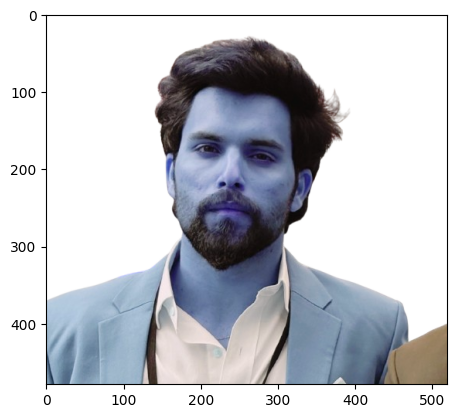

In [ ]:
#simple way to show image
plt.imshow(img)

### 1.1.2. Convert image to gray color

In [ ]:
#convert image to gray scale
# METHOD #2 cv2.cvtColor() : Converts an image from one color space to another.
# Color Space Conversions : Reference : https://docs.opencv.org/3.4/d8/d01/group__imgproc__color__conversions.html
gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
print(gray.shape)
print(gray)


(50, 50)
[[180 181 181 ...  41  41  40]
 [181 181 176 ...  43  44  43]
 [180 178 173 ...  47  52  53]
 ...
 [ 18  18  19 ...  33  35  36]
 [ 17  17  17 ...  34  37  38]
 [ 17  17  16 ...  35  37  38]]


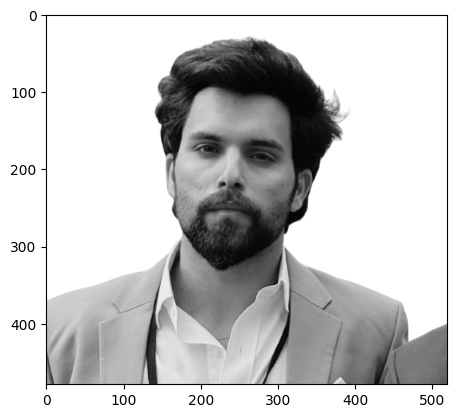

In [ ]:
plt.imshow(gray,cmap='gray')

### 1.1.3. Get Face and Eyes from image 

In [ ]:
import cv2.data
#use for face and eye detection
# METHOD #3 cv2.CascadeClassifier() : Loads a classifier from a file.
#Opencv Python program for Face Detection
#for face detection explore it for more detail how to use  : Reference : https://www.geeksforgeeks.org/opencv-python-program-face-detection/?ref=header_outind
face_cascade=cv2.CascadeClassifier(cv2.data.haarcascades+'haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades+'haarcascade_eye.xml')

faces = face_cascade.detectMultiScale(gray, 1.3, 5)
faces

### 1.1.4.  Get X,Y, width and height values from image

In [ ]:
# x and y is top left corner of rectangle
# w is width of rectangle
# h is height of rectangle
#(x,y) is top left corner of rectangle and (x+w,y+h) is bottom right corner of rectangle

(x,y,w,h)=faces[0]
x,y,w,h

(141, 100, 200, 200)

### 1.1.5. Draw recetangular of face 

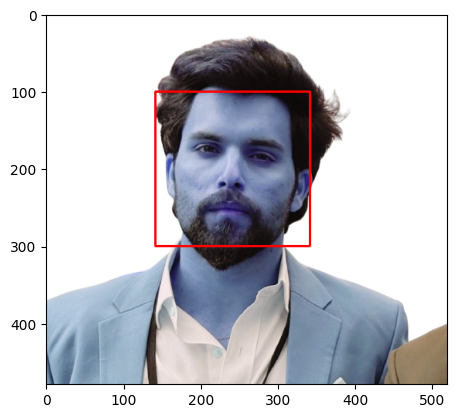

In [ ]:
face_img = cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
plt.imshow(face_img)

### 1.1.6. Draw the eyes

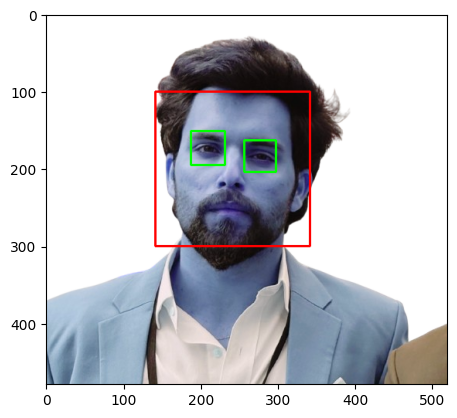

In [ ]:
cv2.destroyAllWindows()
for (x,y,w,h) in faces:
    face_img = cv2.rectangle(img,(x,y),(x+w,y+h),(255,0,0),2)
    roi_gray = gray[y:y+h, x:x+w] ## roi mean region of interest so we crop here only
    roi_color = face_img[y:y+h, x:x+w]
    eyes = eye_cascade.detectMultiScale(roi_gray)
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(0,255,0),2)
        

plt.figure()
plt.imshow(face_img, cmap='gray')
plt.show()

### 1.1.7. Crop the facial region of the image

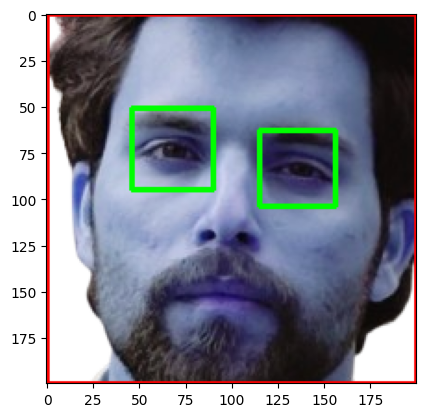

In [ ]:
%matplotlib inline
plt.imshow(roi_color, cmap='gray')

### 1.1.8. Create a method who detect face 

### To avoid false positives images in multiple faces
Set the minNeighbours value to a high value to avoid false positives. Also, you can set the minSize parameter to specify a minimum size of face to be detected. 
### Reference :
### https://stackoverflow.com/questions/52288066/how-to-limit-number-of-faces-detected-by-haar-cascades 

In [ ]:
def get_cropped_image_if_2_eye(image_path):
    img=cv2.imread(image_path)
    gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # face=face_cascade.detectMultiScale(gray)
    #Thanks to stackoverflow for this method to avoid false positive face detection
    face = face_cascade.detectMultiScale(
            gray,
            scaleFactor=1.2,
            minNeighbors=4,
            minSize=(50,50),
            flags=cv2.CASCADE_SCALE_IMAGE
        )
    for (x,y,w,h) in face:
        roi_gray=gray[y:y+h,x:x+w]
        roi_color=img[y:y+h,x:x+w]
        eyes=eye_cascade.detectMultiScale(roi_gray)
        return roi_color
        if(len(eyes))>=2:
            return roi_color
        


Lets test my original image on this fucntion first I will show my image then I will use this method for detect image face

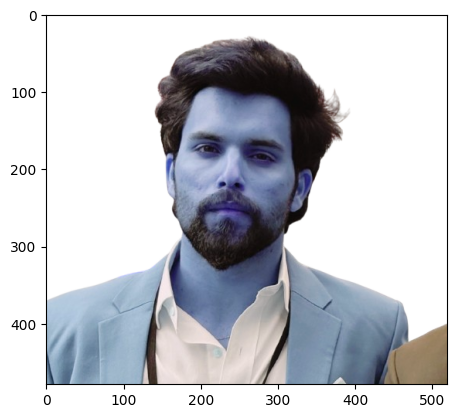

In [ ]:
original_image=cv2.imread('./my_image/image.png')
plt.imshow(original_image)

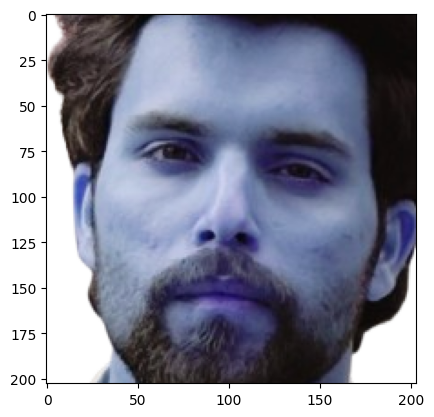

In [ ]:
cropped_img=get_cropped_image_if_2_eye('./my_image/image.png')
plt.imshow(cropped_img)

## 1.2. Pre Processing for Machine Learning :
Read all student name folder and a video  from device that will use for  face detection

We have two source of data one is images that I took from the `class` and second is video that is took by `Ismail` for `4 minutes` . Before Cropping we will check is class images is enough for dataset or we need video for more data. Lets do together

### 1.2.1 Assign Path for `name_labels` and `cropped` Folders
#### Read images from folder

We will read images from the `name_labels` folder . The base directory for `name_labels` is:

```python
path_to_data = './realdataset/name_labels/'
```



#### Directory Structure
We organize the name_labels images as follows:

```
./realdataset/name_labels/
│── abhinav
│── gerid
│── hadi
│── hasham
│── hassan
│── Haxhiu Arion
│── ismail
│── mellisa
│── nestor
│── Tuan Anh NGUYEN
│── ubaid
│── usman
│── yousef
│── zahid
└── zeev
```

Each subfolder contains images corresponding to the respective student. This structure ensures organized data storage for further processing.


In [ ]:
path_to_data_copy='./realdataset_copy/name_labels/' #  realdataset_copy directory  is same as  realdataset we are using just for backup 
path_to_data='./realdataset/name_labels/'
path_to_cr_data='./realdataset/cropped/'


### 1.2.2 load all folder directory from `name_labels` and save their name into a `img_dirs` array

In [ ]:
import os
# List to store folder names and their image count
img_dirs = []

# Iterate through each folder in the main directory
for entry in os.scandir(path_to_data_copy):
    if entry.is_dir():  # Check if it's a folder
        img_count = len([f for f in os.listdir(entry.path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
        img_dirs.append((entry.name, img_count))  # Store folder name and image count

# Display folder names and image counts
for folder_name, count in img_dirs:
    print(f"Folder: {folder_name}, Images: {count}")





Folder: abhinav, Images: 6
Folder: gerid, Images: 12
Folder: hadi, Images: 10
Folder: hasham, Images: 10
Folder: hassan, Images: 11
Folder: Haxhiu Arion, Images: 9
Folder: ismail, Images: 23
Folder: mellisa, Images: 9
Folder: nestor, Images: 6
Folder: Tuan Anh NGUYEN, Images: 10
Folder: ubaid, Images: 11
Folder: usman, Images: 2
Folder: yousef, Images: 10
Folder: zahid, Images: 9
Folder: zeev, Images: 13


### 1.2.3 Detect Faces in video


As you can see above there are too less images of each student so thats why we need to use video for more images 

so there are alot of people identify in the video so use that images to paste in this path `'./realdataset/name_labels/'` in each related student name and my task here to manually go and copy paste from each folder images to `name_labels` folder

So after exploring stackoverflow I found the easiest way to code for detect faces from images and now I will use that code.

Detect Faces in video, crop them and save all frames in the same order - opencv python

`Thanks for stackoverflow` for below code 
#### Reference : https://stackoverflow.com/questions/60546695/detect-faces-in-video-crop-them-and-save-all-frames-in-the-same-order-opencv 

### Uncomment only when need to save faces from video

In [ ]:
'''
import os
import cv2
import numpy as np

# Reference : https://stackoverflow.com/questions/60546695/detect-faces-in-video-crop-them-and-save-all-frames-in-the-same-order-opencv 
# Function to calculate distance between two points
def dist(x1, x2, y1, y2):
    return np.sqrt(((x2 - x1) ** 2) + ((y2 - y1) ** 2))  # Corrected distance formula

# Set the path for class video folder
class_video_folder = "class_video"  # Change this to your desired path

# Ensure the class video folder exists
os.makedirs(class_video_folder, exist_ok=True)

# Load Haar Cascade
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Open video file (Make sure the path is correct)
# video_path = os.path.join(class_video_folder, "Video.mp4")  # Change this if needed
video_path = "Video.mp4"  # If the video is in the same directory as the script

vidcap = cv2.VideoCapture(video_path)
success, image_v = vidcap.read()
count = 0

# Check if video is opened correctly
if not success:
    print(f"Error: Could not open video file at {video_path}")
    exit()

fps = int(vidcap.get(cv2.CAP_PROP_FPS))  # Frames per second
frame_limit = 100 * fps  # Process only the first 5 seconds

students = {}  # Dictionary to store student ID and face locations

while success and count < frame_limit:
    # gimg = cv2.cvtColor(image_v, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
    faces = face_cascade.detectMultiScale(image_v, scaleFactor=1.1, minNeighbors=5)

    for i, (x, y, w, h) in enumerate(faces):
        crop_face = image_v[max(0, y-10):y + h+10, max(0, x-10):x + w+10]  # Crop face with bounds checking

        # Assign each face to a student folder based on its position
        matched_student = None
        for student_id, (sx, sy, sw, sh) in students.items():
            if dist(x, sx, y, sy) < 50:  # If face is close to an existing student
                matched_student = student_id
                break

        if matched_student is None:
            student_id = f"student_{len(students) + 1}"
            students[student_id] = (x, y, w, h)
            student_folder = os.path.join(class_video_folder, student_id)
            os.makedirs(student_folder, exist_ok=True)
        else:
            student_id = matched_student
            student_folder = os.path.join(class_video_folder, student_id)

        filename = os.path.join(student_folder, f"frame{count}.jpg")
        cv2.imwrite(filename, crop_face)
        print(f"Saved: {filename}")

    success, image_v = vidcap.read()
    count += 1

vidcap.release()
cv2.destroyAllWindows()
print("Processing complete for first 5 seconds.")
print("Student folders created:")


'''

'\nimport os\nimport cv2\nimport numpy as np\n\n# Reference : https://stackoverflow.com/questions/60546695/detect-faces-in-video-crop-them-and-save-all-frames-in-the-same-order-opencv \n# Function to calculate distance between two points\ndef dist(x1, x2, y1, y2):\n    return np.sqrt(((x2 - x1) ** 2) + ((y2 - y1) ** 2))  # Corrected distance formula\n\n# Set the path for class video folder\nclass_video_folder = "class_video"  # Change this to your desired path\n\n# Ensure the class video folder exists\nos.makedirs(class_video_folder, exist_ok=True)\n\n# Load Haar Cascade\nface_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + \'haarcascade_frontalface_default.xml\')\n\n# Open video file (Make sure the path is correct)\n# video_path = os.path.join(class_video_folder, "Video.mp4")  # Change this if needed\nvideo_path = "Video.mp4"  # If the video is in the same directory as the script\n\nvidcap = cv2.VideoCapture(video_path)\nsuccess, image_v = vidcap.read()\ncount = 0\n\n# Check i

### 1.2.4 After adding images in `name_labels`  folder from video here is updated images per student

In [ ]:
import os
# List to store folder names and their image count
img_dirs = []

# Iterate through each folder in the main directory
for entry in os.scandir(path_to_data):
    if entry.is_dir():  # Check if it's a folder
        img_count = len([f for f in os.listdir(entry.path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
        img_dirs.append((entry.name, img_count))  # Store folder name and image count

# Display folder names and image counts
for folder_name, count in img_dirs:
    print(f"Folder: {folder_name}, Images: {count}")


Folder: abhinav, Images: 858
Folder: Algassimou DIALLO, Images: 64
Folder: Eli, Images: 2
Folder: gerid, Images: 554
Folder: hadi, Images: 70
Folder: hasham, Images: 329
Folder: hassan, Images: 290
Folder: Haxhiu Arion, Images: 438
Folder: imtiaz, Images: 76
Folder: ismail, Images: 155
Folder: Juliana, Images: 534
Folder: mellisa, Images: 498
Folder: Nabila, Images: 912
Folder: nestor, Images: 6
Folder: Tuan Anh NGUYEN, Images: 84
Folder: Tuan HOANG, Images: 998
Folder: ubaid, Images: 294
Folder: usman, Images: 321
Folder: yousef, Images: 216
Folder: zahid, Images: 17
Folder: zeev, Images: 183


In [ ]:
# path_to_class_video_data='./class_video/'
# import os
# class_img_dirs=[]
# for entry in os.scandir(path_to_class_video_data):
#     if entry.is_dir():
#         class_img_dirs.append(entry.path)
# class_img_dirs





In [ ]:

#how many student we have
len(img_dirs)




21

### 1.2.4 Create another folder `cropped` in side then `realdataset`

`! Alert` it will delete all your cropped images and create new folder on same name  so think before executes 

In [ ]:
# import shutil
# if os.path.exists(path_to_cr_data):
#     shutil.rmtree(path_to_cr_data)
# os.mkdir(path_to_cr_data)

### 1.2.5 Create method save_cropped_image for Save Cropped Image in folders
Uncomment the code if you want to re again save cropped image into folder

In [ ]:
# cropped_img_dirs = []
# student_file_name_dict = {}

# def save_cropped_image(entry, count, student_name):
#     roi_color = get_cropped_image_if_2_eye(entry.path)  # Detect cropped face
#     if roi_color is not None:
#         cropped_folder = os.path.join(path_to_cr_data, student_name)  # Correct folder path
#         if not os.path.exists(cropped_folder):
#             os.makedirs(cropped_folder)
#             cropped_img_dirs.append(cropped_folder)
#             print("Generating cropped images in folder:", cropped_folder)

#         cropped_file_name = f"{student_name}{count}.png"
#         cropped_file_path = os.path.join(cropped_folder, cropped_file_name)

#         cv2.imwrite(cropped_file_path, roi_color)
        
#         # Ensure dictionary key exists
#         if student_name not in student_file_name_dict:
#             student_file_name_dict[student_name] = []
        
#         student_file_name_dict[student_name].append(cropped_file_path)
                

### 1.2.6 Here we load all folder name like student name from student_label folder then display which will use in cropped image

In [ ]:
# for img_dir in img_dirs:
#     count = 1
#     folder_name = img_dir[0]  # Extract the folder name
#     student_name = os.path.basename(folder_name) # Extract only the folder name

#     student_folder_path = os.path.join(path_to_data, folder_name)  # Construct full path

# # Ensure the folder exists before scanning
#     if not os.path.exists(student_folder_path):
#         print(f"Warning: Folder '{student_folder_path}' not found. Skipping...")
#         continue

#     student_file_name_dict[student_name] = []  # Initialize dictionary key
    
#     print(f"Processing images for student: {student_name}")

#     for entry1 in os.scandir(student_folder_path):
#         # save_cropped_image(entry1, count, student_name)
#         count += 1

As we already saved cropped images here we only load images to avoid again and again cropped than save

In [ ]:
import os
cropped_img_dirs=[]

for entry in os.scandir(path_to_cr_data):
    if entry.is_dir():
        cropped_img_dirs.append(entry.path)
cropped_img_dirs

['./realdataset/cropped/abhinav',
 './realdataset/cropped/Algassimou DIALLO',
 './realdataset/cropped/Eli',
 './realdataset/cropped/gerid',
 './realdataset/cropped/hadi',
 './realdataset/cropped/hasham',
 './realdataset/cropped/hassan',
 './realdataset/cropped/Haxhiu Arion',
 './realdataset/cropped/imtiaz',
 './realdataset/cropped/ismail',
 './realdataset/cropped/Juliana',
 './realdataset/cropped/mellisa',
 './realdataset/cropped/Nabila',
 './realdataset/cropped/nestor',
 './realdataset/cropped/Tuan Anh NGUYEN',
 './realdataset/cropped/Tuan HOANG',
 './realdataset/cropped/ubaid',
 './realdataset/cropped/usman',
 './realdataset/cropped/yousef',
 './realdataset/cropped/zahid',
 './realdataset/cropped/zeev']

### 1.2.7 Updated cropped folder detail 
Now you  have cropped folder  that contains cropped images
So, we will manually examine cropped folder and delete any unwanted images
and here is the remaining images after deleting few other than face images 

In [ ]:
student_file_names_dict = {}
for img_dir in cropped_img_dirs:
    student_name = img_dir.split('/')[-1]
    file_list = []
    for entry in os.scandir(img_dir):
        file_list.append(entry.path)
    student_file_names_dict[student_name] = file_list
student_file_names_dict
#count number of images in each folder

for key in student_file_names_dict.keys():
    print("Student "+key+" has  "+str(len(student_file_names_dict[key]))+" images")

Student abhinav has  851 images
Student Algassimou DIALLO has  63 images
Student Eli has  2 images
Student gerid has  551 images
Student hadi has  54 images
Student hasham has  323 images
Student hassan has  277 images
Student Haxhiu Arion has  434 images
Student imtiaz has  73 images
Student ismail has  147 images
Student Juliana has  522 images
Student mellisa has  496 images
Student Nabila has  910 images
Student nestor has  6 images
Student Tuan Anh NGUYEN has  75 images
Student Tuan HOANG has  990 images
Student ubaid has  282 images
Student usman has  289 images
Student yousef has  206 images
Student zahid has  16 images
Student zeev has  172 images


### 1.2.8 Now if you want to create more images like transformation of real crop image into a zoom , flip, further crop , etc. 
Below I created few methods for transformation of images only execute this code when I need more images 


In [ ]:


#rotation angle in degree
# rotated = ndimage.rotate(image_to_rotate, 45)

In [ ]:
# Create a method to zoom image 
def zoomImage(image):
    scale = 1.3
    h, w, _ = image.shape
    center = (w // 2, h // 2)
    zoom_matrix = cv2.getRotationMatrix2D(center, 0, scale)
    zoomed = cv2.warpAffine(image, zoom_matrix, (w, h))
    zoomed = np.clip(zoomed, 0, 255).astype(np.uint8)
    return zoomed


Now we want to apply transformation on images in this case spicy library becaise due to its short code 
### Reference : https://stackoverflow.com/questions/9041681/opencv-python-rotate-image-by-x-degrees-around-specific-point


In [ ]:
from scipy import ndimage
def rotateImage(image):
    rotated = ndimage.rotate(image, 45, reshape=False)  # Keep same dimensions
    rotated = np.clip(rotated, 0, 255).astype(np.uint8)  # Convert back to uint8
    return rotated


In [ ]:
#method to flip image
def flipImage(image):
    flipped = np.fliplr(image) # Flip left-right
    return flipped

### Only execute this code when we have only cropped images anf if we want more dataset for training 

In [ ]:

#lets get each image from folder then apply regulization like rotation , flip,zoom etc then save in same foder with same name
'''

for folder in os.listdir(path_to_cr_data):
    print(f"Generating Augmented images for folder: {folder}")
    
    folder_path = os.path.join(path_to_cr_data, folder)
    if not os.path.isdir(folder_path):
        continue  # Skip if it's not a folder

    for image_name in os.listdir(folder_path):
        if image_name.endswith(('.png', '.jpg', '.jpeg')):
            print(f"Processing: {image_name}")
            
            image_path = os.path.join(folder_path, image_name)
            image = cv2.imread(image_path)

            if image is None:
                print(f"Skipping {image_name}, could not read the image.")
                continue

            # # Create new filename for rotated image
            name, ext = os.path.splitext(image_name)  # Extract name and extension

            #This code is use for rotate each image in folder - Uncomment to use
            rotated_image_path = os.path.join(folder_path, f"{name}_rotated{ext}")

            # Save the rotated image with new name
            #we call method rotateImage to rotate image
            cv2.imwrite(rotated_image_path, rotateImage(image))

            print(f"Saved rotated image: {rotated_image_path}")
            
            #This code is use for zoom each image in folder - Uncomment to use

            zoom_image_path = os.path.join(folder_path, f"{name}_zoom{ext}")

            # Save the rotated image with new name
            #we call method rotateImage to rotate image
            # cv2.imwrite(zoom_image_path, zoomImage(image))

            # print(f"Saved rotated image: {zoom_image_path}")
            
            
            #This code is use for flip each image in folder - Uncomment to use

            # flipped_image_path = os.path.join(folder_path, f"{name}_flipped{ext}")
            # cv2.imwrite(flipped_image_path, flipImage(image))
            # print(f"Saved rotated image: {flipped_image_path}") 
            
            
'''

   


Generating Augmented images for folder: abhinav
Processing: abhinav1.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav1_rotated.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav1_zoom.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav1_flipped.png
Processing: abhinav2.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav2_rotated.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav2_zoom.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav2_flipped.png
Processing: abhinav4.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav4_rotated.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav4_zoom.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav4_flipped.png
Processing: abhinav5.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav5_rotated.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav5_zoom.png
Saved rotated image: ./realdataset/cropped/abhinav\abhinav5_flipped.png


In [ ]:
class_dict = {}
def display_class_directory():
   
    count = 0
    for student_name in student_file_names_dict.keys():
        class_dict[student_name] = count
        count = count + 1
    print(class_dict)

display_class_directory()

{'abhinav': 0, 'Algassimou DIALLO': 1, 'Eli': 2, 'gerid': 3, 'hadi': 4, 'hasham': 5, 'hassan': 6, 'Haxhiu Arion': 7, 'imtiaz': 8, 'ismail': 9, 'Juliana': 10, 'mellisa': 11, 'Nabila': 12, 'nestor': 13, 'Tuan Anh NGUYEN': 14, 'Tuan HOANG': 15, 'ubaid': 16, 'usman': 17, 'yousef': 18, 'zahid': 19, 'zeev': 20}


Images in cropped folder can be used for model training. We will use these raw images along with wavelet transformed images to train our classifier. Let's prepare X and y now

## 1.1.6  Preprocessing: Use wavelet transform as a feature for traning our model

In wavelet transformed image, you can see edges clearly and that can give us clues on various facial features such as eyes, nose, lips etc
Wavelet transform
## Thanks stackoverflow for this wavelet transform 
### Reference : https://stackoverflow.com/questions/24536552/how-to-combine-pywavelet-and-opencv-for-image-processing 

In [ ]:
import numpy as np
import pywt
import cv2    
def w2d(img, mode='haar', level=1):
    imArray = img
    #Datatype conversions
    #convert to grayscale
    imArray = cv2.cvtColor( imArray,cv2.COLOR_RGB2GRAY )
    #convert to float
    imArray =  np.float32(imArray)   
    imArray /= 255
    # compute coefficients 
    coeffs=pywt.wavedec2(imArray, mode, level=level)

    #Process Coefficients
    coeffs_H=list(coeffs)  
    coeffs_H[0] *= 0;  

    # reconstruction
    imArray_H=pywt.waverec2(coeffs_H, mode)
    imArray_H *= 255
    imArray_H =  np.uint8(imArray_H)

    return imArray_H

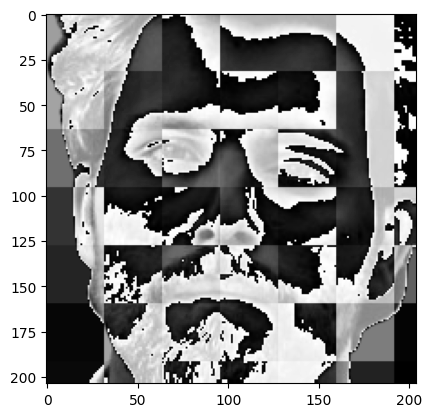

In [ ]:

#this is for testing for first crop image
im_har = w2d(cropped_img,'db1',5)
plt.imshow(im_har, cmap='gray')

### We combine two  scalled_raw_img and  scalled_img_har together 

In [ ]:
X, y = [], []
for student_name, training_files in student_file_names_dict.items():
    for training_image in training_files:
        img = cv2.imread(training_image)
        
        scalled_raw_img = cv2.resize(img, (32, 32))
        #so what is img_har because we convert image into har image
        img_har = w2d(img,'db1',5)
        scalled_img_har = cv2.resize(img_har, (32, 32))
        #so here we combined two image one is raw image and second is har image
        #why we do this because we want to train our model on this two image
        combined_img = np.vstack((scalled_raw_img.reshape(32*32*3,1),scalled_img_har.reshape(32*32,1))) # 32*32,1 menans we have one column 32*32=1024 rows
        #so we have 2 image so we have 1024+1024=2048 rows
        X.append(combined_img)
        y.append(class_dict[student_name])    

c:\Users\HP\anaconda3\envs\tf2.7\lib\site-packages\pywt\_multilevel.py:43: UserWarning: Level value of 5 is too high: all coefficients will experience boundary effects.
  warnings.warn(


In [ ]:
#size of each image is (32*32*3) for scalled image  + (32*32) for har=3072+1024=4096
len(X[0])

4096

In [ ]:
#like this below one image have 4096 pixel values
32*32*3 + 32*32

4096

In [ ]:
#print first image pixel values
X[0]

array([[121],
       [122],
       [126],
       ...,
       [ 40],
       [117],
       [ 11]], dtype=uint8)

In [ ]:
#in this code we reshape our image into 4096 pixel values and we need this because we want to train our model on this pixel values
#just make sure all images has same size of 4096 pixel values 
# and we convert this into float even Int work good just avoid sklearn library error
X = np.array(X).reshape(len(X),4096).astype(float)
X.shape

(6739, 4096)

In [ ]:
#apply preprocessing technoques on imaghe 
#https://stackoverflow.com/questions/63592160/preprocessing-methods-for-face-recognition-in-python
# from sklearn import preprocessing
# #use this for normalize the data
# scaler = preprocessing.StandardScaler().fit(X)
# X = scaler.transform(X)
# print(X)

# In this section we have  `Machine Learning` Model details



# 1. Machine Learning Part 1

## 1.1. SVM Model
Data cleaning process is done. Now we are ready to train our models
## Steps :
1. Split Dataset 
2. Apply Pipeline , Fit model
3. Create classification_report
4. Save model
5. Predict Class Image 




In [ ]:
#import libaries 
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report

### 1.1.1. Split Dataset 

In [ ]:
#split data into train and test and use pipeline and fit SVM model
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.2, random_state=42)

### 1.1.2. Apply Pipeline , Fit model

In [ ]:
#

# PCA 
pipe = Pipeline([('scaler', StandardScaler()), ('svc', SVC(kernel = 'rbf', C = 10))])
pipe.fit(X_train, y_train)
pipe.score(X_test, y_test)

### 1.1.3. Create classification_report

In [ ]:
print(classification_report(y_test, pipe.predict(X_test)))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       188
           1       1.00      1.00      1.00         4
           3       1.00      0.99      1.00       116
           4       1.00      1.00      1.00        16
           5       1.00      0.98      0.99        66
           6       1.00      1.00      1.00        49
           7       0.98      1.00      0.99        83
           8       1.00      1.00      1.00        15
           9       1.00      0.96      0.98        27
          10       1.00      1.00      1.00       110
          11       1.00      1.00      1.00        86
          12       1.00      1.00      1.00       176
          14       0.88      1.00      0.93         7
          15       1.00      1.00      1.00       218
          16       0.96      1.00      0.98        50
          17       0.98      0.98      0.98        56
          18       1.00      1.00      1.00        48
          19       1.00    

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, pipe.predict(X_test))
cm

array([[188,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   4,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0, 115,   0,   0,   0,   1,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,  16,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,  65,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   1,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,  49,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  83,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,  26,   0,   0,   0,   1,
          0,   0,   0,   0,   0

Text(95.72222222222221, 0.5, 'Truth')

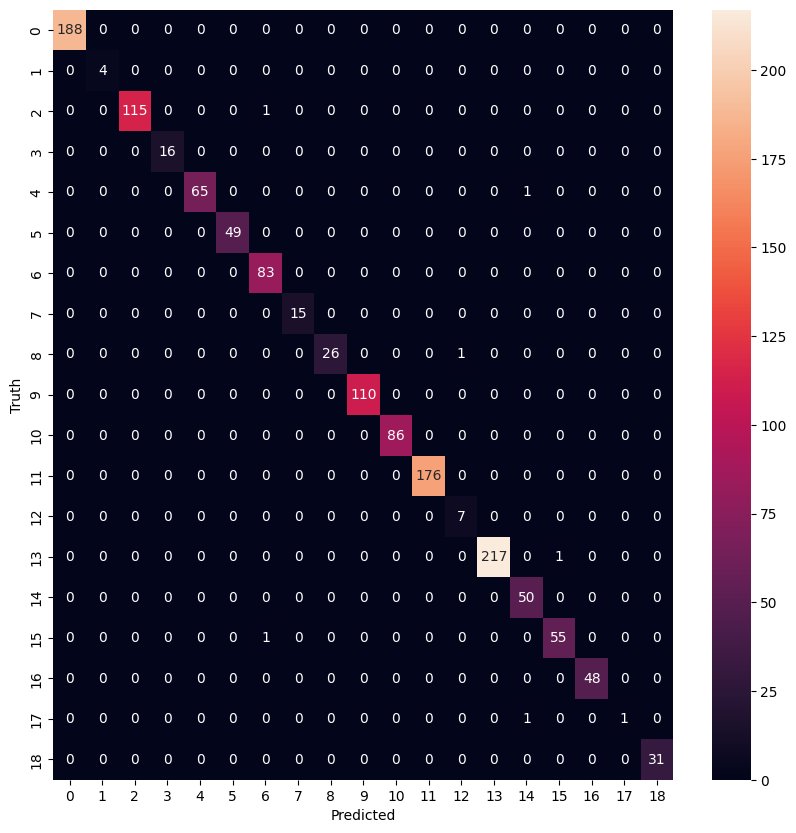

In [ ]:
import seaborn as sn
plt.figure(figsize = (10,10))
sn.heatmap(cm, annot=True,fmt="d")
plt.xlabel('Predicted')
plt.ylabel('Truth')

### 1.1.4. Save SVM Model

In [ ]:
!pip install joblib
import joblib 
# Save the model as a pickle in a file 
joblib.dump(pipe, 'saved_first_svc_model.pkl') 

['saved_first_svc_model.pkl']

In [ ]:
#Save class dictionary
import json
with open("class_dictionary.json","w") as f:
    f.write(json.dumps(class_dict))

### 1.1.4. Predict Class student 


#### Lets test our this model on class images 

#### To avoid false positives images in multiple faces
Set the minNeighbours value to a high value to avoid false positives. Also, you can set the minSize parameter to specify a minimum size of face to be detected. 
 
 Method is :  `face_cascade.detectMultiScale()`
#### Reference :
#### https://stackoverflow.com/questions/52288066/how-to-limit-number-of-faces-detected-by-haar-cascades 


In [ ]:

# # Load face detector

import math
def identify_students(model_path, class_img_path, class_dictionary, output_faces_folder="detected_faces", output_img_path="identified_class_image.jpg"):
    """ Identify students in a class image using a trained model. """
    
    # Load trained model and class dictionary
    best_clf = joblib.load(model_path)
    with open(class_dictionary, "r") as f:
        class_dict = json.load(f)
    reverse_class_dict = {v: k for k, v in class_dict.items()}  # Reverse mapping

    # Ensure output directory exists
    if not os.path.exists(output_faces_folder):
        os.makedirs(output_faces_folder)

    # Load and process class image
    img = cv2.imread(class_img_path)
    if img is None:
        print("Error: Could not read the class image.")
        return
    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)


##############################################################################################################
#                 Dont confused with below code becuse this is preprocessing we already done in preprocessing part
#                 so we just need to predict the image using open cv and haarcascade     
#                 we preprocess on same class image and then predict the image   
#                 and this code will repeat below code so dont confused with this code                       
##################################################################################################################

# Reference :
# https://stackoverflow.com/questions/52288066/how-to-limit-number-of-faces-detected-by-haar-cascades 
    # Detect faces
    faces = face_cascade.detectMultiScale(
        gray,
        scaleFactor=1.2,
        minNeighbors=10,
        minSize=(64, 64),
        flags=cv2.CASCADE_SCALE_IMAGE
    )

    if len(faces) == 0:
        print("No faces detected.")
        return []

    print(f"Detected {len(faces)} face(s).")

    # Sort faces from left to right (by x-coordinate)
    faces = sorted(faces, key=lambda x: x[0])  

    X_test = []
    face_positions = []

    for i, (x, y, w, h) in enumerate(faces):
        face_img = img[y:y+h, x:x+w]
        face_path = os.path.join(output_faces_folder, f"face_{i}.png")
        cv2.imwrite(face_path, face_img)

        # Store face position for visualization
        face_positions.append((x, y, w, h))

        # Preprocess for prediction
        try:
            raw_resized = cv2.resize(face_img, (32, 32))
            img_har = w2d(face_img, 'db1', 5)
            har_resized = cv2.resize(img_har, (32, 32))

            combined_img = np.vstack((raw_resized.reshape(32*32*3, 1), har_resized.reshape(32*32, 1)))
            X_test.append(combined_img)
        except Exception as e:
            print(f"Error processing face {i}: {e}")

    if len(X_test) == 0:
        print("No valid face data for prediction.")
        return []

    X_test = np.array(X_test).reshape(len(X_test), 4096).astype(float)

    # Predict
    predictions = best_clf.predict(X_test)

    # Identify students and show raw class labels
    identified_students = [reverse_class_dict.get(pred, "Unknown") for pred in predictions]

    # Print class labels alongside detected faces
    print("\nPredicted Labels and Identified Students:")
    for i, (predicted_label, student_name) in enumerate(zip(predictions, identified_students)):
        print(f"Face {i}: Class Label {predicted_label} -> {student_name}")

    # Draw bounding boxes and labels on the image
    for (x, y, w, h), student_name, predicted_label in zip(face_positions, identified_students, predictions):
        cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)
        label_text = f"{student_name} ({predicted_label})"
        cv2.putText(img, label_text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)

    # Save the labeled image
    cv2.imwrite(output_img_path, img)

    # Show the image with labels (optional)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.title("Identified Students")
    plt.show()

    return identified_students, predictions



In [ ]:
def display_detected_faces(output_faces_folder, identified_students, predictions):
    """ Display detected face images in a grid (3 columns) along with their predicted student names and class labels. """
    
    face_files = os.listdir(output_faces_folder)
    num_images = len(face_files)

    if num_images == 0:
        print("No detected faces found in the folder.")
        return

    # Sort face files to match the predicted order
    face_files = sorted(face_files, key=lambda f: int(f.split('_')[1].split('.')[0]))  # Sort by face index
    
    # Determine the number of rows needed
    num_cols = 5
    num_rows = math.ceil(num_images / num_cols)

    # Adjust figure size dynamically
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 3))  # Each image gets a 3-inch height
    axes = axes.flatten()  # Flatten for easy iteration

    for i, (face_path, student_name, predicted_label) in enumerate(zip(face_files, identified_students, predictions)):
        face_img = cv2.imread(os.path.join(output_faces_folder, face_path))
        face_img = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for correct color display

        label_text = f"{student_name} ({predicted_label})"  # Display student name with predicted label
        
        axes[i].imshow(face_img)
        axes[i].set_title(label_text, fontsize=12)
        axes[i].axis("off")
    
    # Hide any unused subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis("off")
    
    plt.tight_layout()
    plt.show()


Detected 12 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 3 -> gerid
Face 1: Class Label 11 -> mellisa
Face 2: Class Label 3 -> gerid
Face 3: Class Label 18 -> yousef
Face 4: Class Label 18 -> yousef
Face 5: Class Label 0 -> abhinav
Face 6: Class Label 16 -> ubaid
Face 7: Class Label 3 -> gerid
Face 8: Class Label 15 -> Tuan HOANG
Face 9: Class Label 20 -> zeev
Face 10: Class Label 17 -> usman
Face 11: Class Label 3 -> gerid


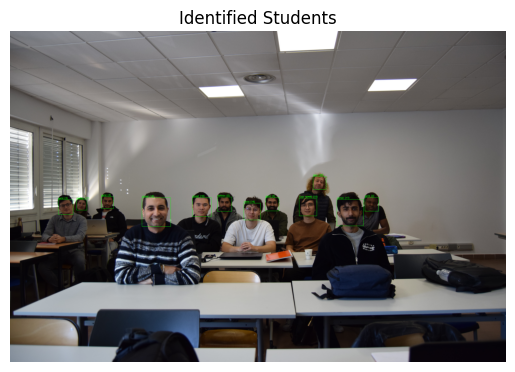

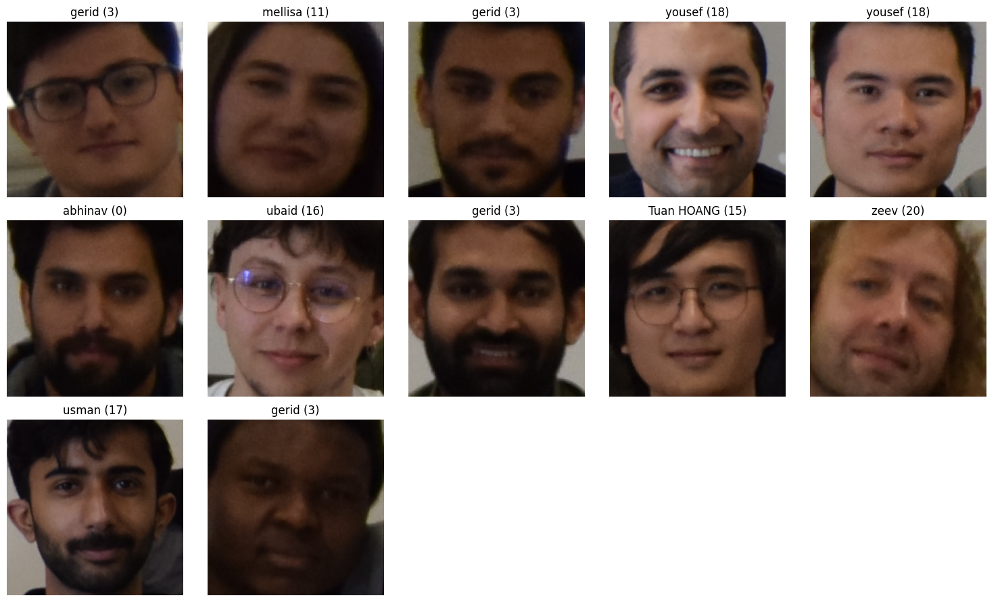

In [ ]:
# Load the model and class dictionary
model_path = "saved_first_svc_model.pkl"
class_img_path = "./class_images/1.jpg"
class_dictionary = "class_dictionary.json"
identified_students, predictions = identify_students(model_path,class_img_path,class_dictionary)
display_detected_faces("detected_faces", identified_students, predictions)




#### The result are not good 

#### Lets Try multiple other class images for testing 

Detected 9 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 15 -> Tuan HOANG
Face 1: Class Label 3 -> gerid
Face 2: Class Label 8 -> imtiaz
Face 3: Class Label 3 -> gerid
Face 4: Class Label 5 -> hasham
Face 5: Class Label 16 -> ubaid
Face 6: Class Label 11 -> mellisa
Face 7: Class Label 3 -> gerid
Face 8: Class Label 18 -> yousef


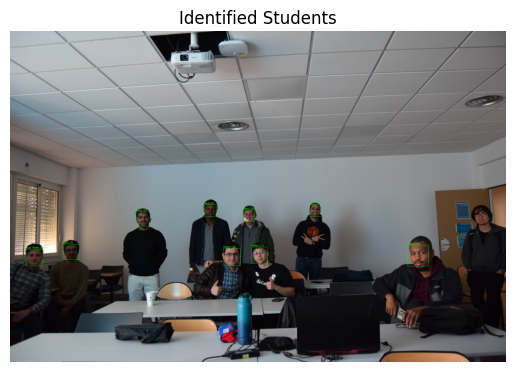

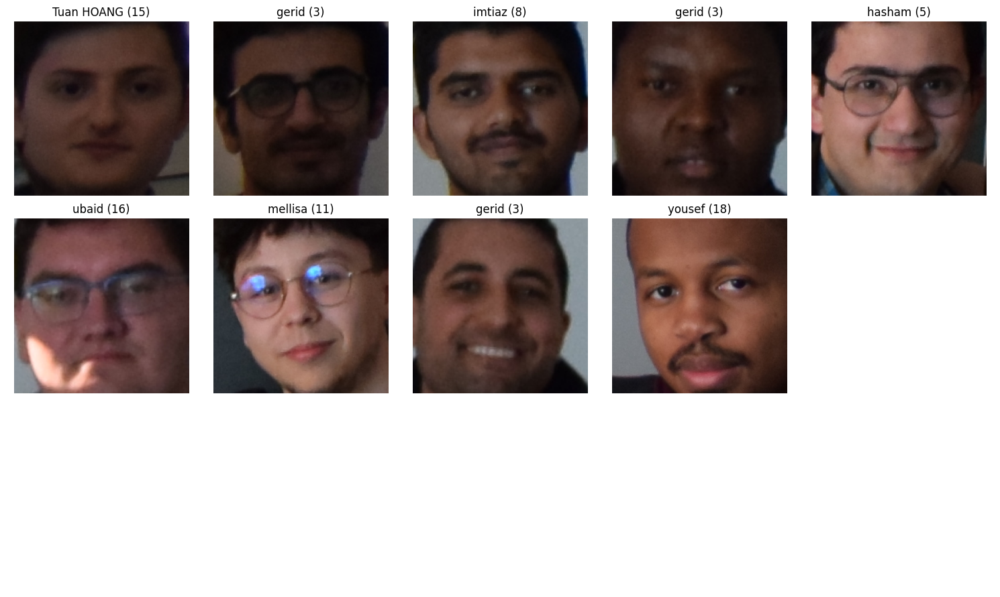

In [ ]:

class_img_path = "./class_images/3.jpg"

identified_students, predictions = identify_students(model_path,class_img_path,class_dictionary)
display_detected_faces("detected_faces", identified_students, predictions)

## 1.2 Apply GridSearchCV with different ML models (`SVM`,`RandomForestClassifier`, `LogisticRegression` )


As you can see above the predection has not same as mention in classification report to overcome this now I  want to create multiple models then I will aplly GridRearchCV 

## What we should know
1. As we know the X shape is `(6739, 4096)`  so there are `4096` features if we apply GridRearchCV it will take too much time so for this we will use PCA to reduce the size of feature(Columns) to `500` coulumns.
2. But for GridSearch we will use `HalvingGridSearchCV` due to its good performance
2. Then we will use three models like (`SVM`,`RandomForestClassifier`, `LogisticRegression` )
3. For above I am going to create one common pipeline for all models 
4. predict the test dataset with best model and save it
5. As we already test class images now we will use new best model for test class image 


## Steps : 
1. load libraries
2. Set model_params
3. Use PCA and fit model
4. Select best model
5. predict class image 

Let's use HalvingGridSearchCV to try out different models with different paramets.
 Goal is to come up with best modle with best fine tuned parameters

### 1.2.1. Load libraries

In [ ]:
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from sklearn.model_selection import HalvingGridSearchCV

### 1.2.2.  Set model_params

In [ ]:
model_params = {
    'svm': {
        'model': svm.SVC(gamma='auto', probability=True),
        'params': {
            'svc__C': [1, 10, 100],  # Fewer values for faster testing or use this 'svc__C': [1,10,100,1000], 
            'svc__kernel': ['rbf']   # Remove 'linear' for faster testing or use this 'svc__kernel': ['rbf','linear']
        }
    },
    'random_forest': {
        'model': RandomForestClassifier(),
        'params': {
            'randomforestclassifier__n_estimators': [5, 10]  # Fewer values for faster testing or use this 'randomforestclassifier__n_estimators': [1,5,10]
        }
    },
    'logistic_regression': {
        'model': LogisticRegression(solver='liblinear', multi_class='auto'),
        'params': {
            'logisticregression__C': [1, 5, 10] # Fewer values for faster testing or use this 'logisticregression__C': [1,5,10,100]
        }
    }
}

### 1.2.3.  Use PCA and fit model

##### Use PCA to convert 4096 features to 500 for faster execution and only take important face features

Use HalvingGridSearchCV instead of GridSearchCV for faster search

HalvingRandomSearchCV vs GridSearchCV
##### Reference : https://medium.com/@tom.kaminski01/halvingrandomsearchcv-vs-gridsearchcv-f1cd42f54b3b 

In [ ]:


best_estimators = {}
scores = []

for algo, mp in model_params.items():
    pipe = make_pipeline(StandardScaler(), PCA(n_components=500), mp['model'])  # Let pipeline handle PCA 
    
    clf = HalvingGridSearchCV(pipe, mp['params'], factor=2, cv=3, verbose=1)
    clf.fit(X, y)  # Use X (4096 features) directly, don't pre-transform
    
    scores.append({
        'model': algo,
        'best_score': clf.best_score_,
        'best_params': clf.best_params_
    })
    best_estimators[algo] = clf.best_estimator_


df = pd.DataFrame(scores, columns=['model', 'best_score', 'best_params'])
print(df)

n_iterations: 2
n_required_iterations: 2
n_possible_iterations: 2
min_resources_: 3369
max_resources_: 6739
aggressive_elimination: False
factor: 2
----------
iter: 0
n_candidates: 3
n_resources: 3369
Fitting 3 folds for each of 3 candidates, totalling 9 fits


c:\Users\HP\anaconda3\envs\tf2.7\lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


----------
iter: 1
n_candidates: 2
n_resources: 6738
Fitting 3 folds for each of 2 candidates, totalling 6 fits


c:\Users\HP\anaconda3\envs\tf2.7\lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


n_iterations: 2
n_required_iterations: 2
n_possible_iterations: 2
min_resources_: 3369
max_resources_: 6739
aggressive_elimination: False
factor: 2
----------
iter: 0
n_candidates: 2
n_resources: 3369
Fitting 3 folds for each of 2 candidates, totalling 6 fits


c:\Users\HP\anaconda3\envs\tf2.7\lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


----------
iter: 1
n_candidates: 1
n_resources: 6738
Fitting 3 folds for each of 1 candidates, totalling 3 fits


c:\Users\HP\anaconda3\envs\tf2.7\lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


n_iterations: 2
n_required_iterations: 2
n_possible_iterations: 2
min_resources_: 3369
max_resources_: 6739
aggressive_elimination: False
factor: 2
----------
iter: 0
n_candidates: 3
n_resources: 3369
Fitting 3 folds for each of 3 candidates, totalling 9 fits


c:\Users\HP\anaconda3\envs\tf2.7\lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


----------
iter: 1
n_candidates: 2
n_resources: 6738
Fitting 3 folds for each of 2 candidates, totalling 6 fits


c:\Users\HP\anaconda3\envs\tf2.7\lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=3.
  warnings.warn(


                 model  best_score  \
0                  svm    0.748509   
1        random_forest    0.780878   
2  logistic_regression    0.926662   

                                    best_params  
0         {'svc__C': 100, 'svc__kernel': 'rbf'}  
1  {'randomforestclassifier__n_estimators': 10}  
2                 {'logisticregression__C': 10}  


In [ ]:
# calculate accuracy of all 
for model_name, model in best_estimators.items():
    score = model.score(X_test, y_test)  # Pipeline applies PCA automatically
    print(f"{model_name} Accuracy: {score}")


svm Accuracy: 1.0
random_forest Accuracy: 1.0
logistic_regression Accuracy: 1.0


### 1.2.4.  Select Bast Model

In [ ]:
best_estimators

{'svm': Pipeline(steps=[('standardscaler', StandardScaler()),
                 ('pca', PCA(n_components=500)),
                 ('svc', SVC(C=100, gamma='auto', probability=True))]),
 'random_forest': Pipeline(steps=[('standardscaler', StandardScaler()),
                 ('pca', PCA(n_components=500)),
                 ('randomforestclassifier',
                  RandomForestClassifier(n_estimators=10))]),
 'logistic_regression': Pipeline(steps=[('standardscaler', StandardScaler()),
                 ('pca', PCA(n_components=500)),
                 ('logisticregression',
                  LogisticRegression(C=10, solver='liblinear'))])}

In [ ]:
best_clf = best_estimators['logistic_regression']

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, best_clf.predict(X_test))
cm

array([[188,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   4,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0, 116,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,  16,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,  66,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,  49,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,  83,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,  15,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,  27,   0,   0,   0,   0,
          0,   0,   0,   0,   0

Text(95.72222222222221, 0.5, 'Truth')

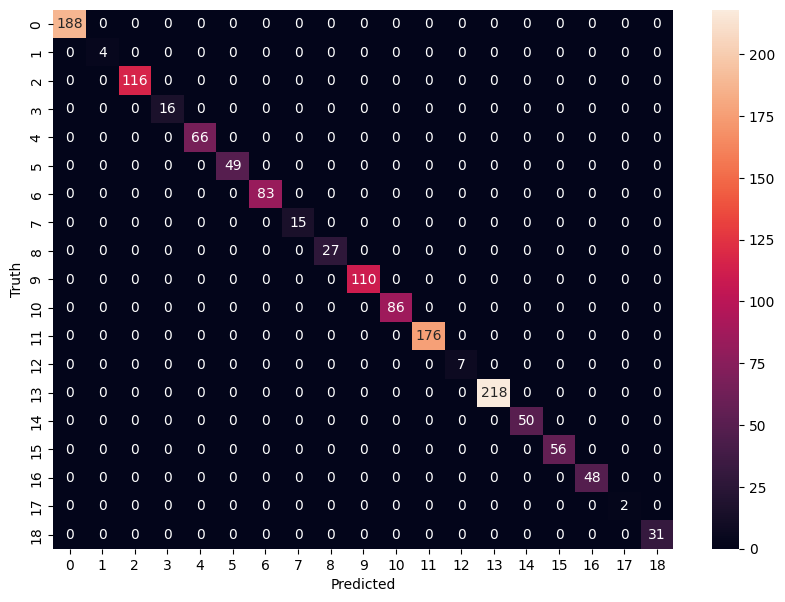

In [ ]:
import seaborn as sn
plt.figure(figsize = (10,7))
sn.heatmap(cm, annot=True,fmt="d")
plt.xlabel('Predicted')
plt.ylabel('Truth')

In [ ]:
class_dict

{'abhinav': 0,
 'Algassimou DIALLO': 1,
 'Eli': 2,
 'gerid': 3,
 'hadi': 4,
 'hasham': 5,
 'hassan': 6,
 'Haxhiu Arion': 7,
 'imtiaz': 8,
 'ismail': 9,
 'Juliana': 10,
 'mellisa': 11,
 'Nabila': 12,
 'nestor': 13,
 'Tuan Anh NGUYEN': 14,
 'Tuan HOANG': 15,
 'ubaid': 16,
 'usman': 17,
 'yousef': 18,
 'zahid': 19,
 'zeev': 20}

Save the trained model

In [ ]:
# !pip install joblib
# import joblib 
# Save the model as a pickle in a file 
# joblib.dump(best_clf, 'saved_best_model_ML.pkl') 

['saved_best_model_ML.pkl']

In [ ]:
#Save class dictionary
import json
with open("class_dictionary.json","w") as f:
    f.write(json.dumps(class_dict))

In [ ]:

# class_img_path = "./class_images/1.jpg"


In [ ]:

# identified_students, predictions = identify_students(model_path,class_img_path,class_dictionary)
# display_detected_faces("detected_faces", identified_students, predictions)

### 1.2.4. Test model on class image
 Lets try mutiple class images for testing

 Scroll down for viewing the all results of `8 images of class`

Detected 16 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 6 -> hassan
Face 1: Class Label 15 -> Tuan HOANG
Face 2: Class Label 17 -> usman
Face 3: Class Label 11 -> mellisa
Face 4: Class Label 16 -> ubaid
Face 5: Class Label 18 -> yousef
Face 6: Class Label 15 -> Tuan HOANG
Face 7: Class Label 0 -> abhinav
Face 8: Class Label 17 -> usman
Face 9: Class Label 5 -> hasham
Face 10: Class Label 20 -> zeev
Face 11: Class Label 12 -> Nabila
Face 12: Class Label 10 -> Juliana
Face 13: Class Label 7 -> Haxhiu Arion
Face 14: Class Label 12 -> Nabila
Face 15: Class Label 7 -> Haxhiu Arion


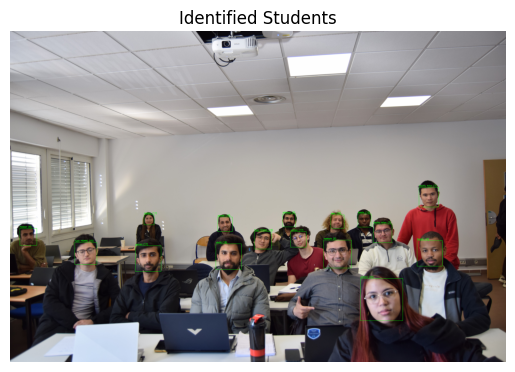

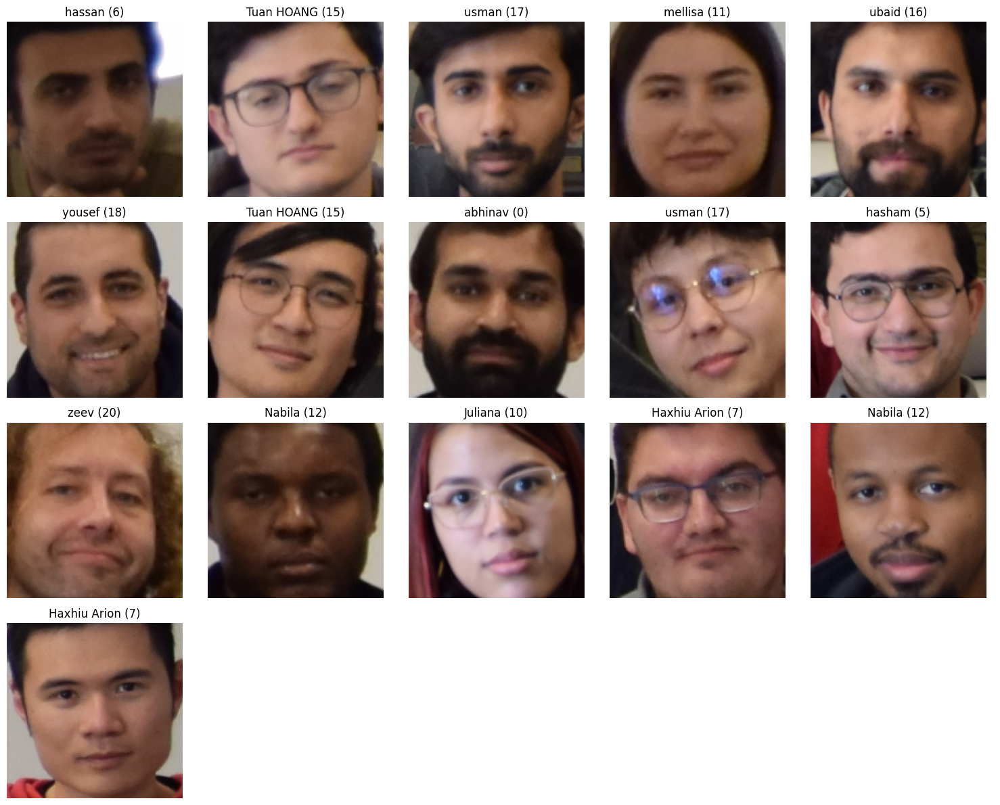

Detected 10 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 3 -> gerid
Face 1: Class Label 0 -> abhinav
Face 2: Class Label 6 -> hassan
Face 3: Class Label 15 -> Tuan HOANG
Face 4: Class Label 17 -> usman
Face 5: Class Label 0 -> abhinav
Face 6: Class Label 17 -> usman
Face 7: Class Label 12 -> Nabila
Face 8: Class Label 7 -> Haxhiu Arion
Face 9: Class Label 0 -> abhinav


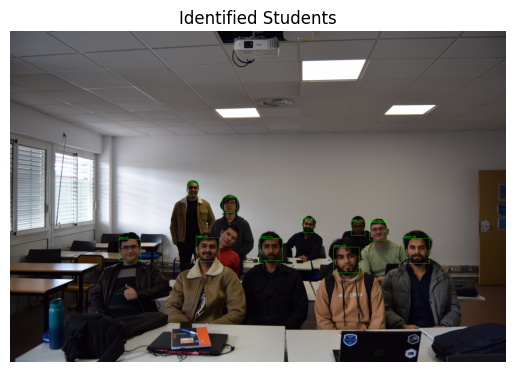

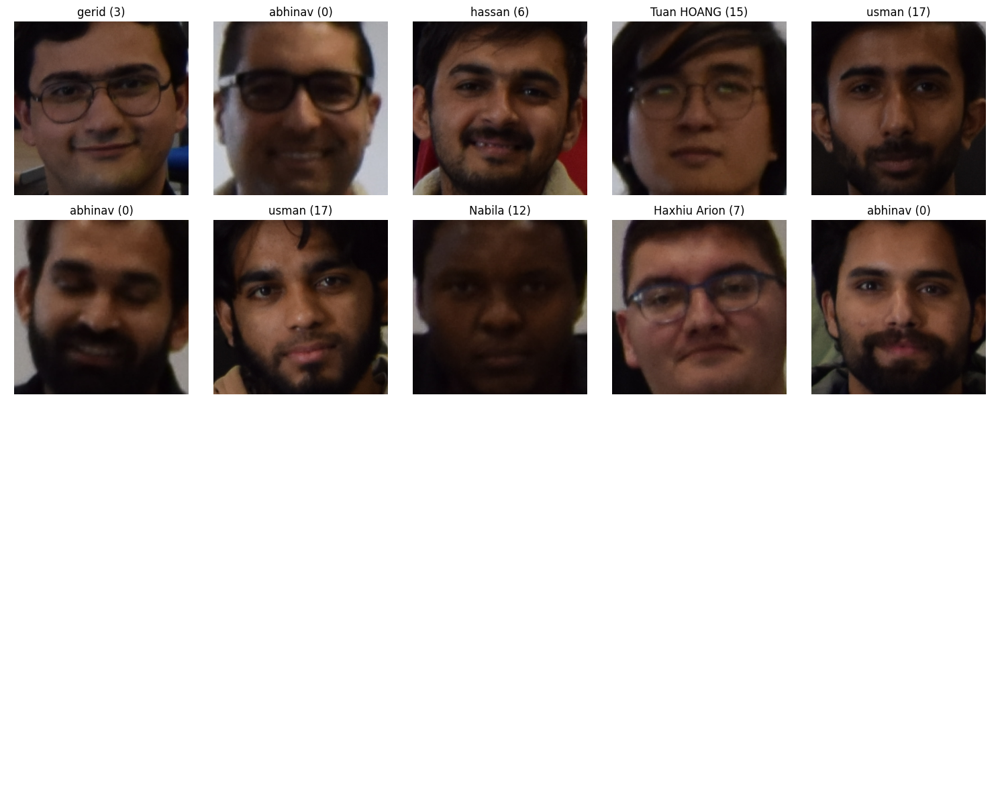

Detected 10 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 3 -> gerid
Face 1: Class Label 0 -> abhinav
Face 2: Class Label 6 -> hassan
Face 3: Class Label 15 -> Tuan HOANG
Face 4: Class Label 17 -> usman
Face 5: Class Label 0 -> abhinav
Face 6: Class Label 17 -> usman
Face 7: Class Label 12 -> Nabila
Face 8: Class Label 7 -> Haxhiu Arion
Face 9: Class Label 0 -> abhinav


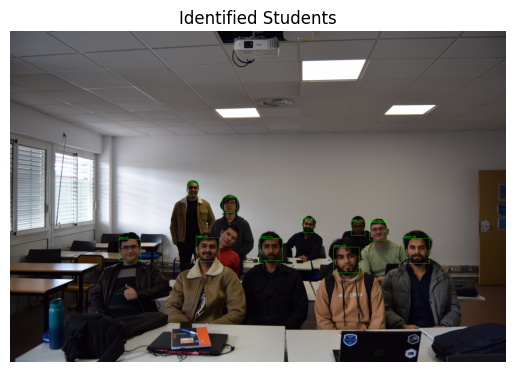

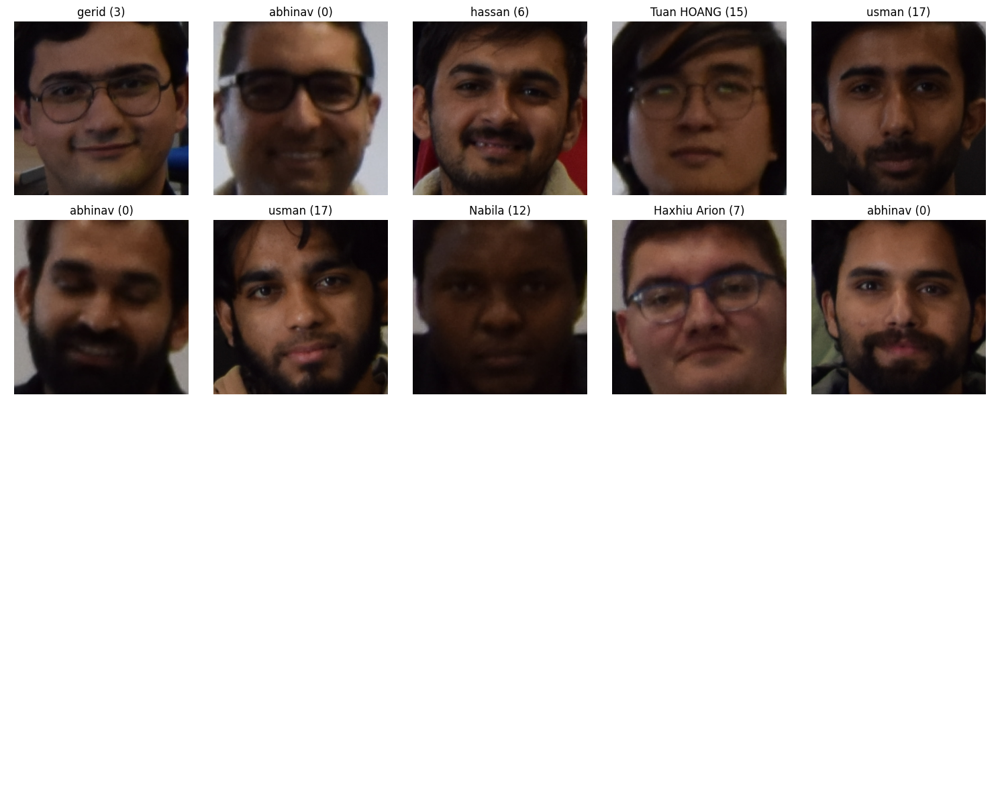

Detected 12 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 0 -> abhinav
Face 1: Class Label 6 -> hassan
Face 2: Class Label 0 -> abhinav
Face 3: Class Label 0 -> abhinav
Face 4: Class Label 0 -> abhinav
Face 5: Class Label 15 -> Tuan HOANG
Face 6: Class Label 18 -> yousef
Face 7: Class Label 0 -> abhinav
Face 8: Class Label 15 -> Tuan HOANG
Face 9: Class Label 5 -> hasham
Face 10: Class Label 7 -> Haxhiu Arion
Face 11: Class Label 20 -> zeev


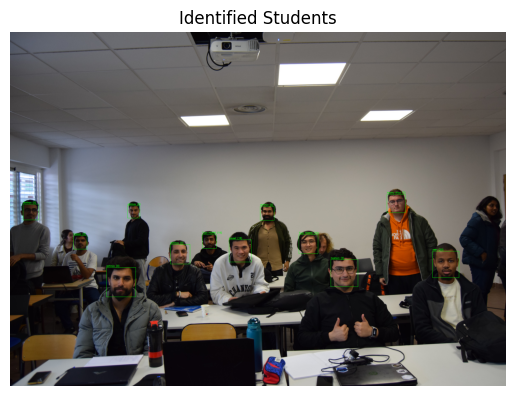

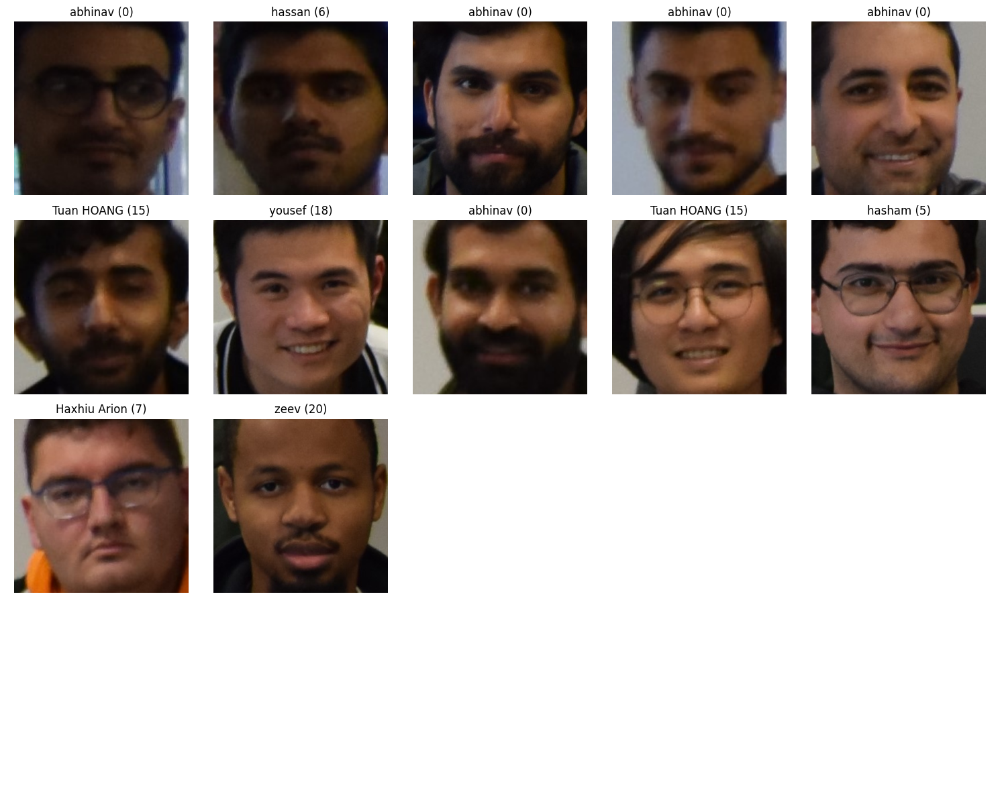

Detected 12 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 15 -> Tuan HOANG
Face 1: Class Label 18 -> yousef
Face 2: Class Label 5 -> hasham
Face 3: Class Label 15 -> Tuan HOANG
Face 4: Class Label 0 -> abhinav
Face 5: Class Label 20 -> zeev
Face 6: Class Label 15 -> Tuan HOANG
Face 7: Class Label 12 -> Nabila
Face 8: Class Label 18 -> yousef
Face 9: Class Label 15 -> Tuan HOANG
Face 10: Class Label 5 -> hasham
Face 11: Class Label 1 -> Algassimou DIALLO


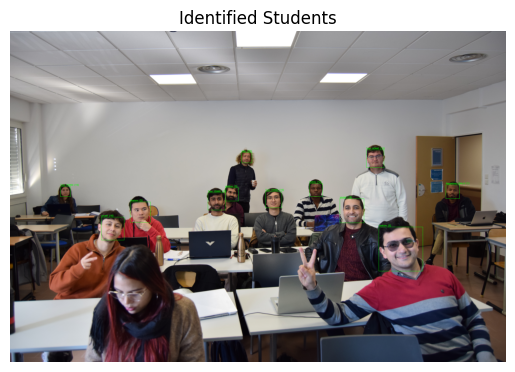

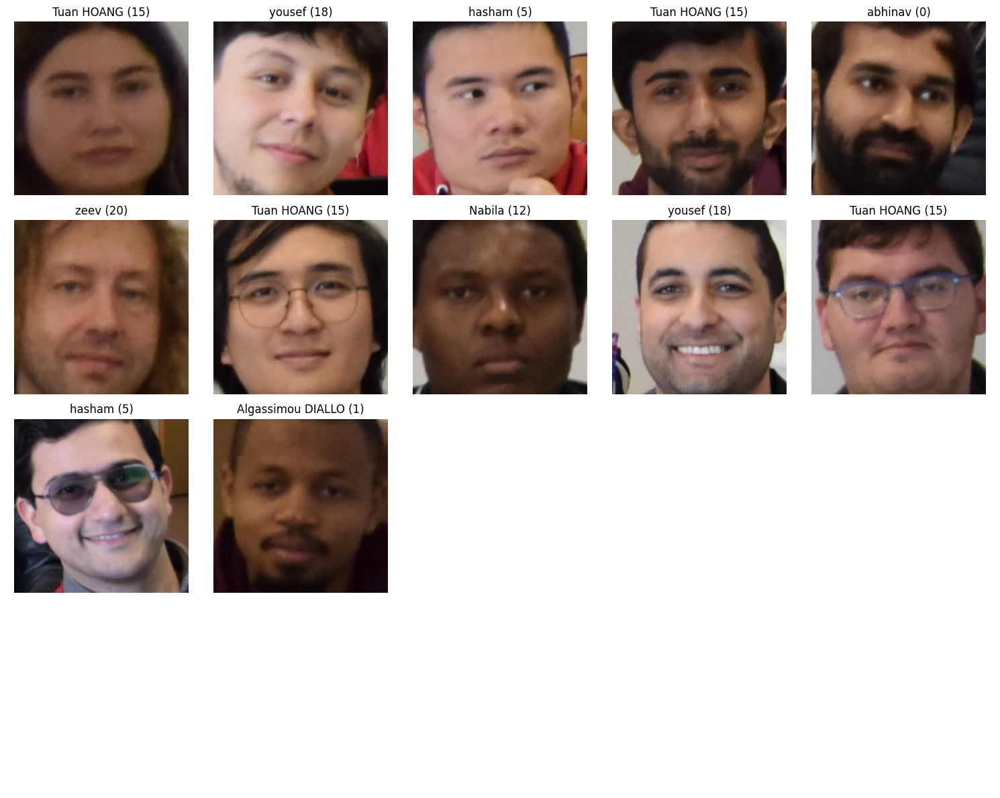

Detected 8 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 11 -> mellisa
Face 1: Class Label 7 -> Haxhiu Arion
Face 2: Class Label 20 -> zeev
Face 3: Class Label 15 -> Tuan HOANG
Face 4: Class Label 3 -> gerid
Face 5: Class Label 0 -> abhinav
Face 6: Class Label 15 -> Tuan HOANG
Face 7: Class Label 12 -> Nabila


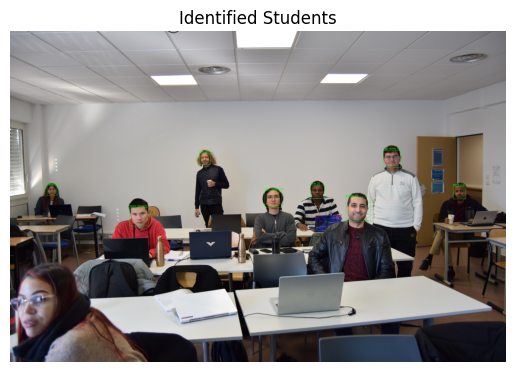

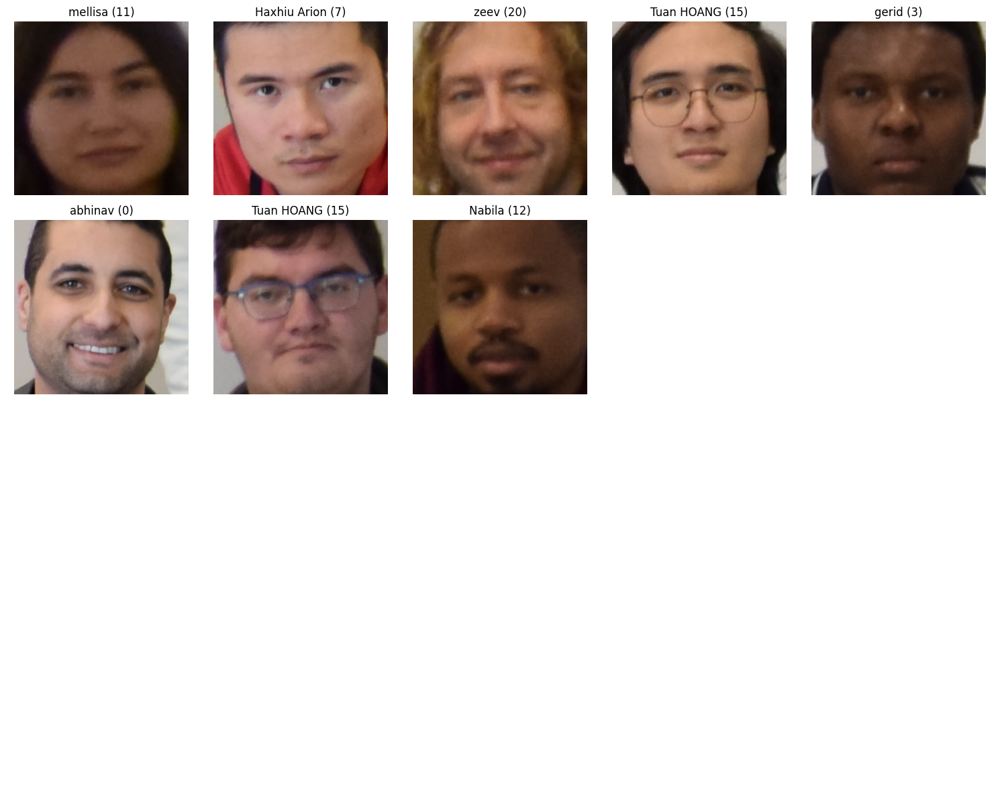

Detected 10 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 3 -> gerid
Face 1: Class Label 0 -> abhinav
Face 2: Class Label 6 -> hassan
Face 3: Class Label 15 -> Tuan HOANG
Face 4: Class Label 17 -> usman
Face 5: Class Label 0 -> abhinav
Face 6: Class Label 17 -> usman
Face 7: Class Label 12 -> Nabila
Face 8: Class Label 7 -> Haxhiu Arion
Face 9: Class Label 0 -> abhinav


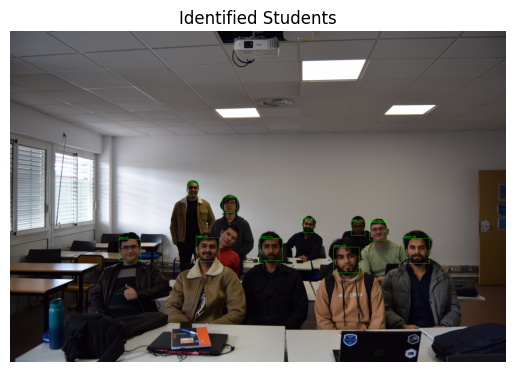

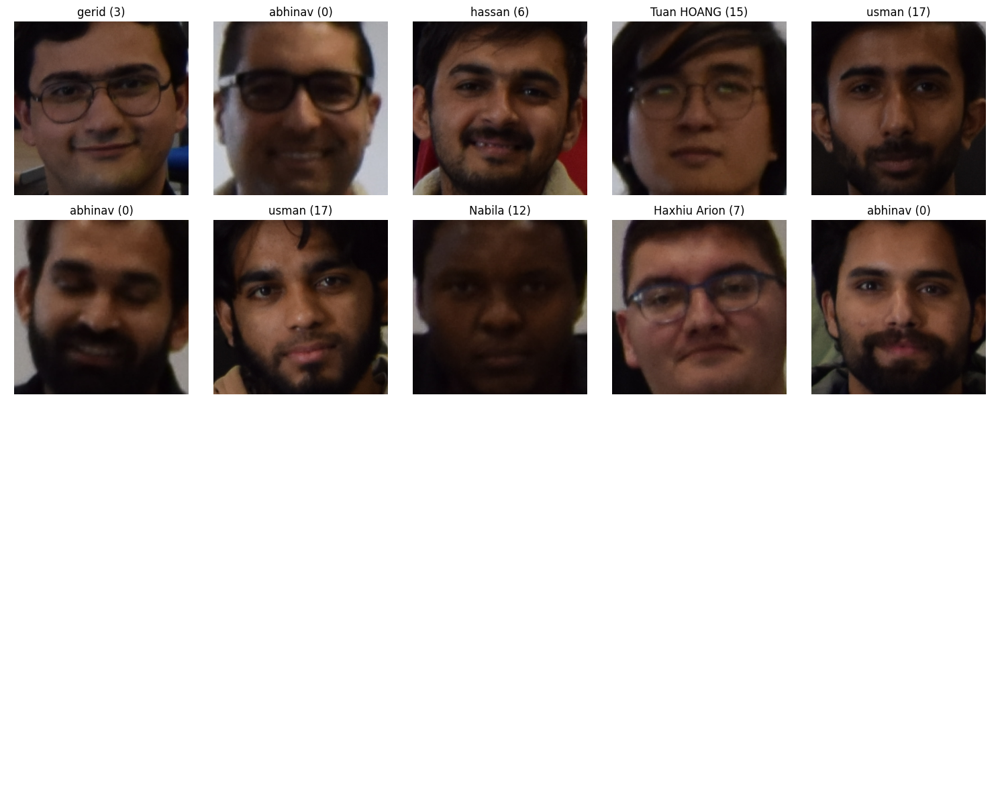

Detected 3 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 20 -> zeev
Face 1: Class Label 20 -> zeev
Face 2: Class Label 3 -> gerid


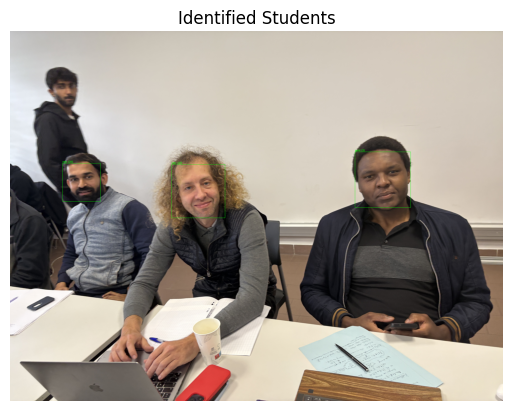

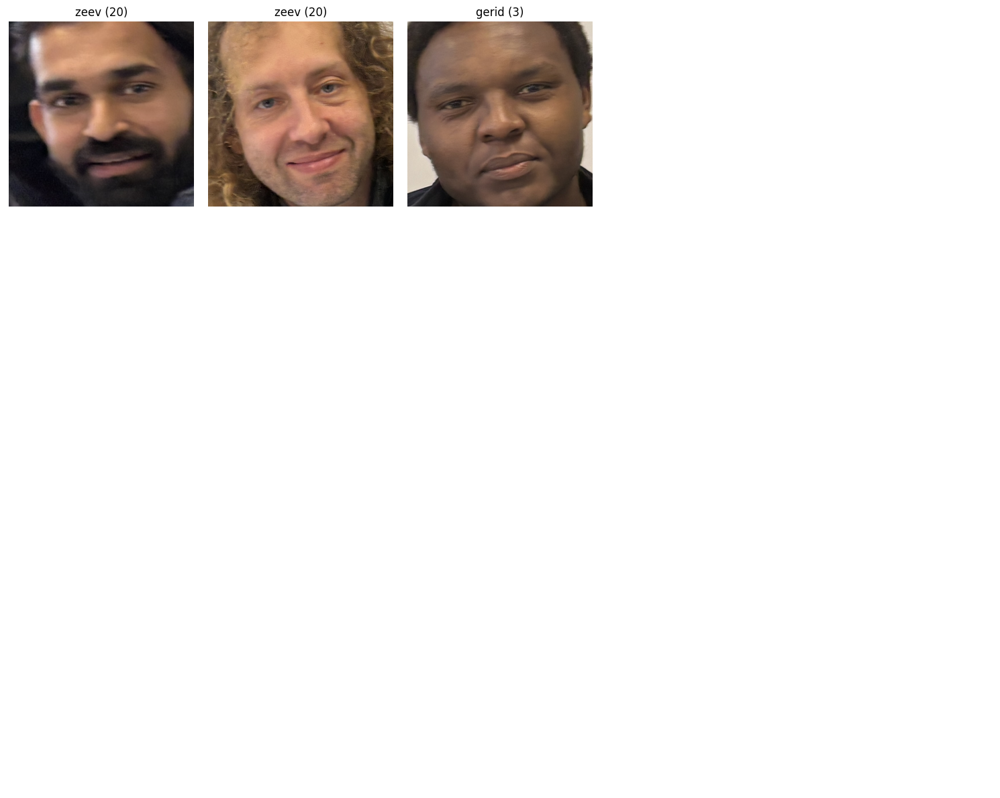

Detected 2 face(s).

Predicted Labels and Identified Students:
Face 0: Class Label 12 -> Nabila
Face 1: Class Label 12 -> Nabila


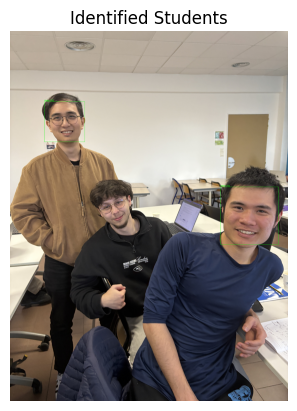

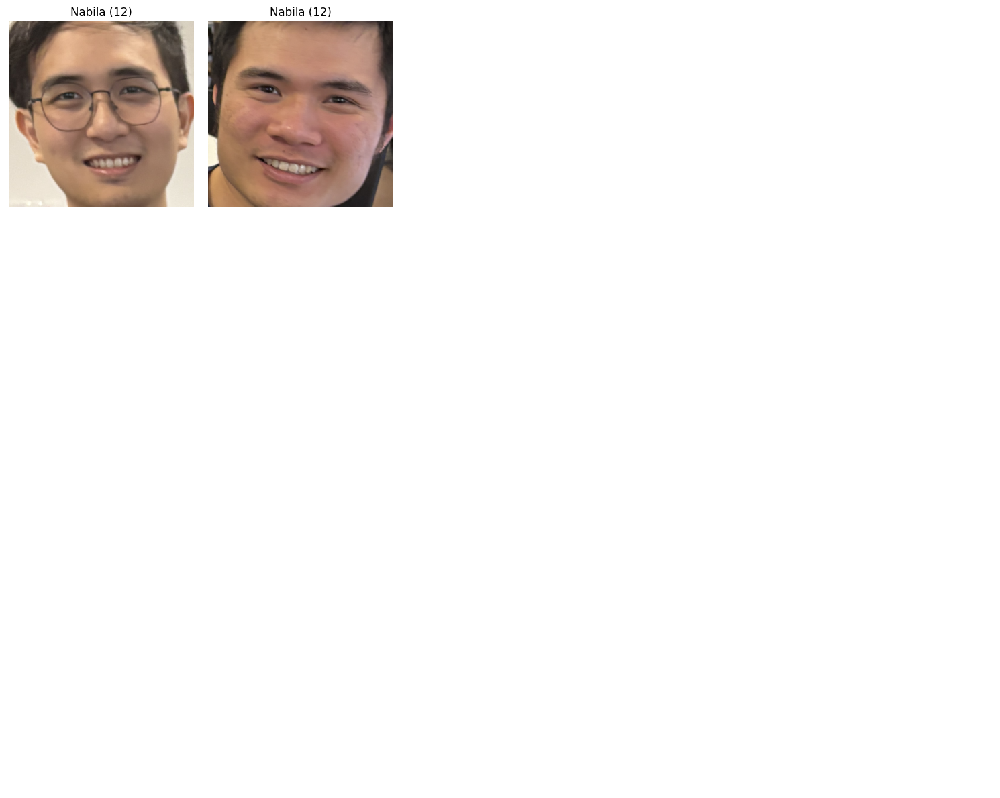

In [ ]:
import os
## Load the model and class dictionary
model_path = "saved_best_model_ML.pkl"
class_dictionary = "class_dictionary.json"
p = "./class_images/"

# get all images from class_images folder
class_img_paths = [os.path.join(p, f"{i}.jpg") for i in range(6, 14)]  # Adjust range as needed

# Predict all images using above methods 
for class_img_path in class_img_paths:
    identified_students, predictions = identify_students(model_path, class_img_path, class_dictionary)
    if identified_students is None or predictions is None:
        print(f"Error processing {class_img_path}: identify_students() returned None")
    else:
        display_detected_faces("detected_faces", identified_students, predictions)


<h2>Conclusion for Machine Learning Algorithms</h2>
    <p>The tasks I performed in this project using Machine Learning models:</p>
    <ol>
        <li>Created a dataset using student images or class videos.</li>
        <li>Using my image, I explained in detail how the OpenCV library <code>haar-cascades</code> works for face and eye detection.</li>
        <li>Read all the images from the folder and checked whether they were sufficient for modeling. Since they were not enough, we used video to capture more faces.</li>
        <li>After processing the video, we had enough images for the model, but we also created a method for image transformation (zoom, flip, crop, etc.) to be used as needed.</li>
        <li>Applied wavelet transform to detect image edges. In the wavelet-transformed image, edges are clearly visible, helping to identify various facial features such as eyes, nose, and lips.</li>
        <li>Combined both the original cropped image (32,32,3) and the wavelet-transformed image (32,32,1) to obtain a <code>4096</code>-feature vector.</li>
        <li>Initially, we used an SVM model, which provided decent results but was not highly accurate, as only 3 to 4 students were correctly predicted.</li>
        <li>Then, we tested multiple models, including SVM, RandomForestClassifier, and LogisticRegression. The results were:</li>
    </ol>
    <table border="1">
        <tr>
            <th>Model</th>
            <th>Best Score</th>
        </tr>
        <tr>
            <td>SVM</td>
            <td>0.748509</td>
        </tr>
        <tr>
            <td>Random Forest</td>
            <td>0.780878</td>
        </tr>
        <tr>
            <td>Logistic Regression</td>
            <td>0.926662</td>
        </tr>
    </table>
    <p>This is why I chose Logistic Regression as the best model for prediction. It performed better than SVM but still requires improvement.</p>
    <p>Finally, we displayed images of each detected student in the classroom and added prediction labels to their images.</p>


# 2. Deep Learning Part 2

 But for better result now we are going to apply Deep Learning approch 

# Part 2 

# Deep Learning 

So in deeplearning model we will use CNN 
1. We will use original color full crop images (32,32,3) instead of converting into 1D array we will use this shape (32,32,3) and will pass into CNN
2. Instead of using wavelet tranformation on image we will use filter which are in CNN to detect edges 
3. I will use padding in corner of images 
4. Now we have two option or we can use Maxpooling or Average pooling to reduce the size of image we will see which is better 
5. We try to create a CNN in such a way that look good and also cannot take too much time or to complicated.

### 2.1 CNN Model (`using less dataset`)

#### Read this blog for more detail how we use `CNN for Image Classification`

#### Reference : https://www.analyticsvidhya.com/blog/2020/02/learn-image-classification-cnn-convolutional-neural-networks-3-datasets/

So for rigth now we have X in which shape has 4096 with combined image to convert it original 

#### Here is the images that we will use for model

In this section It  can be possible to duplicate the code from above section just to avoid rerun above code 

So on average we have `20` images of each student in their folder to avoid overfitting 

#### 2.1.1 Load folder paths 

In [1]:
path_to_data_copy='./realdataset_copy/name_labels/' #  realdataset_copy directory  is same as  realdataset we are using just for backup 
path_to_data='./realdataset/name_labels/'
path_to_cr_data='./realdataset/cropped/'
path_to_cr_data_copy='./realdataset_copy/croppedc1/'
# path_to_cr_data_copy_croppedc1='./realdataset_copy/croppedc1/'







#### 2.1.2 Display folders  `display_folder_names` Method

In [ ]:
import os

def display_folder_names(path_to_cr_data_copy):
    cropped_img_dirs=[]
    for entry in os.scandir(path_to_cr_data_copy):
        if entry.is_dir():
            cropped_img_dirs.append(entry.path)
    # cropped_img_dirs
    return cropped_img_dirs


In [ ]:
display_folder_names(path_to_cr_data_copy)

#### 2.1.3 Display images count in each folder `display_each_folder_image_count` Method

In [4]:

def display_each_folder_image_count(cropped_img_dirs):
    student_file_names_dict = {}
    # print("Student Name and their total images")
    for img_dir in cropped_img_dirs:
        student_name = img_dir.split('/')[-1]
        file_list = []
        for entry in os.scandir(img_dir):
            file_list.append(entry.path)
        student_file_names_dict[student_name] = file_list
    # student_file_names_dict
    #count number of images in each folder

    # for key in student_file_names_dict.keys():
    #     print("Student "+key+" has  "+str(len(student_file_names_dict[key]))+" images")

    return student_file_names_dict
# display_each_folder_image_count(cropped_img_dirs)

#### 2.1.5 Create dictionary for labels  `display_class_directory` Methods

In [5]:

def display_class_directory(student_file_names_dict):
    class_dict = {}
    # print("Student Name and Class Label:")
    count = 0
    for student_name in student_file_names_dict.keys():
        class_dict[student_name] = count
        count = count + 1
        
    # class_dict
    return class_dict
# display_class_directory(display_each_folder_image_count(display_folder_names(path_to_cr_data_copy)))

In [89]:
n_classes = len(display_class_directory())
n_classes

19

#### 2.1.6 Get dataset X,Y `prepare_training_data` Method

In [11]:
#import openv cv
import numpy as np
import cv2
from tensorflow.keras.utils import to_categorical

In [6]:



def prepare_training_data(cropped_img_dirs,class_dict,img_size):
    X, y = [], []
    for student_name, training_files in display_each_folder_image_count(cropped_img_dirs).items():
        for training_image in training_files:
            img = cv2.imread(training_image)
            if img is None:
              print(f"Skipping unreadable image: {training_image}")
              continue
            scalled_raw_img = cv2.resize(img, (img_size, img_size))
            #so we have 2 image so we have 1024+1024=2048 rows
            X.append(scalled_raw_img)
            y.append(class_dict[student_name])
            
    return X,y



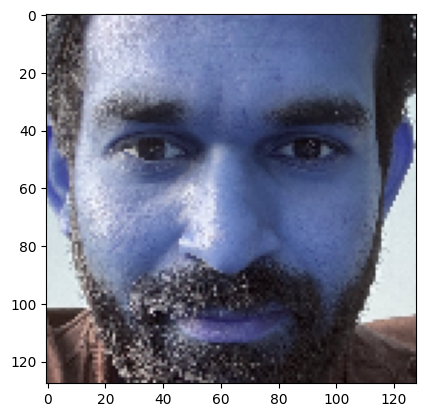

In [57]:
import matplotlib.pyplot as plt
plt.imshow(X[0])
plt.show()

#### 2.1.7 Reshape Method  `re_shape_X_Y` Method

In [ ]:

import numpy as np
from tensorflow.keras.utils import to_categorical

def re_shape_X_Y(X, y, n_classes, img_size):
    X = np.array(X).reshape(len(X), img_size, img_size, 3).astype('float32')
    y = np.array(y)
    # X /= 255
    print("Shape of X", X.shape)
    print("Shape of y", y.shape)
    y_category = to_categorical(y, n_classes)
    print("Shape of y_category", y_category.shape)
    return X, y_category



#### 2.1.8 Call Methods

In [15]:
class_dict=display_class_directory(display_each_folder_image_count(display_folder_names(path_to_cr_data_copy)))
X, y = prepare_training_data(display_folder_names(path_to_cr_data_copy), class_dict,64)
n_classes = len(class_dict)  # Define the number of classes

In [19]:

X_reshape, y_category = re_shape_X_Y(X, y, n_classes,64)

Shape of X (2472, 64, 64, 3)
Shape of y (2472,)
Shape of y_category (2472, 19)


In [20]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_reshape, y_category, test_size=0.2, random_state=42)

#### 2.1.9 Apply CNN

In [ ]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, Flatten, Dense, InputLayer, BatchNormalization, Dropout
from tensorflow.keras.optimizers import Adam
from keras.regularizers import l2

# Create the model
model = Sequential()
model.add(InputLayer(input_shape=(64, 64, 3)))

# 1st conv block
model.add(Conv2D(32, (3, 3), activation='relu', strides=(1, 1), padding='same'))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))

# 2nd conv block
model.add(Conv2D(64, (3, 3), activation='relu', strides=(1, 1), padding='same'))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# 3rd conv block
model.add(Conv2D(128, (3, 3), activation='relu', strides=(1, 1), padding='same'))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# 4th conv block
model.add(Conv2D(256, (3, 3), activation='relu', strides=(1, 1), padding='same'))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# ANN block
model.add(Flatten())
model.add(Dense(units=256, activation='relu', kernel_regularizer=l2(0.01)))  # L2 regularization
model.add(Dropout(0.4))  # Increased dropout
model.add(Dense(units=128, activation='relu', kernel_regularizer=l2(0.01)))  # L2 regularization
model.add(Dropout(0.3))  # Increased dropout

# Output layer
model.add(Dense(units=n_classes, activation='softmax'))

# Compile the model
optimizer = Adam(learning_rate=0.0005)  # Reduced learning rate
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Display the model summary
model.summary()




Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_34 (Conv2D)          (None, 128, 128, 32)      896       
                                                                 
 max_pooling2d_34 (MaxPoolin  (None, 64, 64, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_35 (Conv2D)          (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_35 (MaxPoolin  (None, 32, 32, 64)       0         
 g2D)                                                            
                                                                 
 batch_normalization_25 (Bat  (None, 32, 32, 64)       256       
 chNormalization)                                                
                                                      

#### 2.1.10. Fit Model

In [77]:
# Training the model
model.fit(X_train, y_train, batch_size=64, epochs=30, validation_data=(X_test, y_test))

Epoch 1/30
6/6 [==============================] - 3s 95ms/step - loss: 9.6065 - accuracy: 0.2749 - val_loss: 9.6271 - val_accuracy: 0.1446
Epoch 2/30
6/6 [==============================] - 0s 55ms/step - loss: 8.0195 - accuracy: 0.6133 - val_loss: 9.5521 - val_accuracy: 0.1084
Epoch 3/30
6/6 [==============================] - 0s 53ms/step - loss: 7.5343 - accuracy: 0.6979 - val_loss: 9.4774 - val_accuracy: 0.0723
Epoch 4/30
6/6 [==============================] - 0s 51ms/step - loss: 7.0892 - accuracy: 0.8066 - val_loss: 9.3626 - val_accuracy: 0.0723
Epoch 5/30
6/6 [==============================] - 0s 53ms/step - loss: 6.7989 - accuracy: 0.8520 - val_loss: 9.2412 - val_accuracy: 0.0723
Epoch 6/30
6/6 [==============================] - 0s 50ms/step - loss: 6.5841 - accuracy: 0.8852 - val_loss: 9.2326 - val_accuracy: 0.0723
Epoch 7/30
6/6 [==============================] - 0s 61ms/step - loss: 6.3124 - accuracy: 0.9033 - val_loss: 9.3191 - val_accuracy: 0.0723
Epoch 8/30
6/6 [===========

#### As you can see above there is `overfitting` as we have less data lets use above methods for crop, zoom ,flip to create more images then try with large dataset 

 loss: 2.8873 - accuracy: 0.9849 - val_loss: 10.1384 - val_accuracy: 0.0723      `overfitting issue`

To overcome this lets try to create more images using image transfromation method as I mention methods already in Machine Learning so we will use them and add some extra methods if need

#### 2.1.11 Methods images transfromation

In [78]:
# Create a method to zoom image 
def zoomImage(image):
    scale = 1.3
    h, w, _ = image.shape
    center = (w // 2, h // 2)
    zoom_matrix = cv2.getRotationMatrix2D(center, 0, scale)
    zoomed = cv2.warpAffine(image, zoom_matrix, (w, h))
    zoomed = np.clip(zoomed, 0, 255).astype(np.uint8)
    return zoomed

#Now we want to apply transformation on images in this case spicy library becaise due to its short code 
### Reference : https://stackoverflow.com/questions/9041681/opencv-python-rotate-image-by-x-degrees-around-specific-point
from scipy import ndimage
def rotateImage(image):
    rotated = ndimage.rotate(image, 45, reshape=False)  # Keep same dimensions
    rotated = np.clip(rotated, 0, 255).astype(np.uint8)  # Convert back to uint8
    return rotated


#method to flip image
def flipImage(image):
    flipped = np.fliplr(image) # Flip left-right
    return flipped


# Method to darken image
def darkenImage(image, factor=0.5):
    darkened = np.clip(image * factor, 0, 255).astype(np.uint8)
    return darkened

# Method to brighten image
def brightenImage(image, factor=1.5):
    brightened = np.clip(image * factor, 0, 255).astype(np.uint8)
    return brightened

# Method to add Gaussian noise
def addNoise(image, mean=0, std=25):
    noise = np.random.normal(mean, std, image.shape).astype(np.uint8)
    noisy_image = cv2.add(image, noise)
    return np.clip(noisy_image, 0, 255).astype(np.uint8)

# Method to blur image
def blurImage(image, ksize=(5, 5)):
    return cv2.GaussianBlur(image, ksize, 0)

##### 2.1.11.1 Only execute this code when we  want more dataset for training using image transfromation

In [ ]:

# #lets get each image from folder then apply regulization like rotation , flip,zoom etc then save in same foder with same name


# for folder in os.listdir(path_to_cr_data):
#     print(f"Generating Augmented images for folder: {folder}")
    
#     folder_path = os.path.join(path_to_cr_data, folder)
#     if not os.path.isdir(folder_path):
#         continue  # Skip if it's not a folder

#     for image_name in os.listdir(folder_path):
#         if image_name.endswith(('.png', '.jpg', '.jpeg')):
#             print(f"Processing: {image_name}")
            
#             image_path = os.path.join(folder_path, image_name)
#             image = cv2.imread(image_path)

#             if image is None:
#                 print(f"Skipping {image_name}, could not read the image.")
#                 continue

#             # # Create new filename for rotated image
#             name, ext = os.path.splitext(image_name)  # Extract name and extension

#             #This code is use for rotate each image in folder - Uncomment to use
#             rotated_image_path = os.path.join(folder_path, f"{name}_rotated{ext}")

#             # Save the rotated image with new name
#             #we call method rotateImage to rotate image
#             cv2.imwrite(rotated_image_path, rotateImage(image))

#             print(f"Saved rotated image: {rotated_image_path}")
            
#             #This code is use for zoom each image in folder - Uncomment to use

#             zoom_image_path = os.path.join(folder_path, f"{name}_zoom{ext}")

#             # Save the rotated image with new name
#             #we call method rotateImage to rotate image
#             cv2.imwrite(zoom_image_path, zoomImage(image))

#             print(f"Saved rotated image: {zoom_image_path}")
            
            
#             #This code is use for flip each image in folder - Uncomment to use

#             flipped_image_path = os.path.join(folder_path, f"{name}_flipped{ext}")
#             cv2.imwrite(flipped_image_path, flipImage(image))
#             print(f"Saved rotated image: {flipped_image_path}") 
            
            


   




In [ ]:
# # Apply transformations to each image in the dataset
# for folder in os.listdir(path_to_cr_data_copy):
#     print(f"Generating augmented images for folder: {folder}")
    
#     folder_path = os.path.join(path_to_cr_data_copy, folder)
#     if not os.path.isdir(folder_path):
#         continue  # Skip if it's not a folder

#     for image_name in os.listdir(folder_path):
#         if image_name.endswith(('.png', '.jpg', '.jpeg')):
#             print(f"Processing: {image_name}")
            
#             image_path = os.path.join(folder_path, image_name)
#             image = cv2.imread(image_path)

#             if image is None:
#                 print(f"Skipping {image_name}, could not read the image.")
#                 continue

#             name, ext = os.path.splitext(image_name)  # Extract name and extension

#             # Apply transformations and save
#             augmentations = {
#                 "rotated": rotateImage(image),
#                 "zoomed": zoomImage(image),
#                 "flipped": flipImage(image),
#                 "darkened": darkenImage(image),
#                 "brightened": brightenImage(image),
#                 "noisy": addNoise(image),
#                 "blurred": blurImage(image),
#             }

#             for aug_type, aug_image in augmentations.items():
#                 aug_image_path = os.path.join(folder_path, f"{name}_{aug_type}{ext}")
#                 cv2.imwrite(aug_image_path, aug_image)
#                 print(f"Saved {aug_type} image: {aug_image_path}")

Generating augmented images for folder: abhinav
Processing: abhinav1.png
Saved rotated image: ./realdataset_copy/croppedc1/abhinav\abhinav1_rotated.png
Saved zoomed image: ./realdataset_copy/croppedc1/abhinav\abhinav1_zoomed.png
Saved flipped image: ./realdataset_copy/croppedc1/abhinav\abhinav1_flipped.png
Saved darkened image: ./realdataset_copy/croppedc1/abhinav\abhinav1_darkened.png
Saved brightened image: ./realdataset_copy/croppedc1/abhinav\abhinav1_brightened.png
Saved noisy image: ./realdataset_copy/croppedc1/abhinav\abhinav1_noisy.png
Saved blurred image: ./realdataset_copy/croppedc1/abhinav\abhinav1_blurred.png
Processing: abhinav2.png
Saved rotated image: ./realdataset_copy/croppedc1/abhinav\abhinav2_rotated.png
Saved zoomed image: ./realdataset_copy/croppedc1/abhinav\abhinav2_zoomed.png
Saved flipped image: ./realdataset_copy/croppedc1/abhinav\abhinav2_flipped.png
Saved darkened image: ./realdataset_copy/croppedc1/abhinav\abhinav2_darkened.png
Saved brightened image: ./reald

#### 2.1.12. Now we have a large dataset lets see overfitting is gone or not in CNN 

In [9]:
import cv2
img_size=128
class_dict=display_class_directory(display_each_folder_image_count(display_folder_names(path_to_cr_data_copy)))
X, y = prepare_training_data(display_folder_names(path_to_cr_data_copy), class_dict, img_size)
n_classes = len(class_dict)  # Define the number of classes

In [ ]:

X_reshape, y_category = re_shape_X_Y(X, y, n_classes,img_size)


Shape of X (2472, 128, 128, 3)
Shape of y (2472,)
Shape of y_category (2472, 19)


In [40]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_reshape, y_category, test_size=0.2, random_state=42)

#### 2.1.13. Again Load CNN model

In [41]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPool2D, GlobalAveragePooling2D, Dense, InputLayer, BatchNormalization, Dropout
from tensorflow.keras.optimizers import Adam
from keras.regularizers import l2
# Create the model
model = Sequential()
model.add(InputLayer(input_shape=(img_size, img_size, 3)))

# 1st conv block
model.add(Conv2D(32, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(Conv2D(32, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# 2nd conv block
model.add(Conv2D(64, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(Conv2D(64, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# 3rd conv block
model.add(Conv2D(128, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(Conv2D(128, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# 4th conv block
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(Conv2D(256, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# 5th conv block
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(Conv2D(512, (3, 3), activation='relu', padding='same', kernel_regularizer=l2(0.001)))
model.add(MaxPool2D(pool_size=(2, 2), padding='same'))
model.add(BatchNormalization())

# Global Average Pooling instead of Flatten
model.add(GlobalAveragePooling2D())

# Fully connected layers
model.add(Dense(units=512, activation='relu', kernel_regularizer=l2(0.001)))
model.add(Dropout(0.5))  # Increased dropout
model.add(Dense(units=256, activation='relu', kernel_regularizer=l2(0.001)))
model.add(Dropout(0.4))

# Output layer
model.add(Dense(units=n_classes, activation='softmax'))

# Compile the model
optimizer = Adam(learning_rate=0.0003)  # Lower learning rate for better training stability
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Display the model summary
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_30 (Conv2D)          (None, 128, 128, 32)      896       
                                                                 
 conv2d_31 (Conv2D)          (None, 128, 128, 32)      9248      
                                                                 
 max_pooling2d_15 (MaxPoolin  (None, 64, 64, 32)       0         
 g2D)                                                            
                                                                 
 batch_normalization_15 (Bat  (None, 64, 64, 32)       128       
 chNormalization)                                                
                                                                 
 conv2d_32 (Conv2D)          (None, 64, 64, 64)        18496     
                                                                 
 conv2d_33 (Conv2D)          (None, 64, 64, 64)       

#### 2.1.13. Use GPU for smooth learning 

In [42]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
print("Num CPUs Available: ", len(tf.config.list_physical_devices('CPU')))
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_virtual_device_configuration(
            gpus[0],
            [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=4096)]  # Adjust memory limit as needed
        )
    except RuntimeError as e:
        print(e)

Num GPUs Available:  1
Num CPUs Available:  1
Virtual devices cannot be modified after being initialized


In [44]:
model.fit(X_train, y_train, batch_size=64, epochs=30, validation_data=(X_test, y_test))

Epoch 1/30
31/31 [==============================] - 13s 304ms/step - loss: 4.6630 - accuracy: 0.3682 - val_loss: 5.4291 - val_accuracy: 0.0707
Epoch 2/30
31/31 [==============================] - 4s 116ms/step - loss: 3.6613 - accuracy: 0.6586 - val_loss: 5.6996 - val_accuracy: 0.0747
Epoch 3/30
31/31 [==============================] - 4s 117ms/step - loss: 3.1558 - accuracy: 0.8002 - val_loss: 5.9985 - val_accuracy: 0.0525
Epoch 4/30
31/31 [==============================] - 4s 116ms/step - loss: 2.7821 - accuracy: 0.9039 - val_loss: 7.1654 - val_accuracy: 0.0525
Epoch 5/30
31/31 [==============================] - 4s 115ms/step - loss: 2.6817 - accuracy: 0.9150 - val_loss: 7.4392 - val_accuracy: 0.0384
Epoch 6/30
31/31 [==============================] - 4s 120ms/step - loss: 2.5257 - accuracy: 0.9646 - val_loss: 8.6570 - val_accuracy: 0.0545
Epoch 7/30
31/31 [==============================] - 4s 115ms/step - loss: 2.4136 - accuracy: 0.9818 - val_loss: 8.3213 - val_accuracy: 0.0525
Epoch

#### 2.1.14. Ohhh Thank God! Atlest I got good val_accuracy after such a long process
loss: 0.0954 - accuracy: 1.0000 - val_loss: 0.0926 - val_accuracy: 0.9960   ` good accuracy`

In [45]:
# Evaluate Model
test_loss, test_acc = model.evaluate(X_test, y_test)
print(f"Test accuracy: {test_acc * 100:.2f}%")

16/16 [==============================] - 3s 70ms/step - loss: 1.3091 - accuracy: 0.9960
Test accuracy: 99.60%


#### 2.1.15. Save model

In [46]:
# Save the trained CNN model
model.save('cnn_model_DL_3.h5')

# Save the class dictionary
import json
with open("class_dictionary.json", "w") as f:
    f.write(json.dumps(class_dict))
    

In [47]:
class_dict


{'abhinav': 0,
 'Algassimou DIALLO': 1,
 'gerid': 2,
 'hadi': 3,
 'hasham': 4,
 'hassan': 5,
 'Haxhiu Arion': 6,
 'ismail': 7,
 'Juliana': 8,
 'mellisa': 9,
 'Nabila': 10,
 'nestor': 11,
 'Tuan Anh NGUYEN': 12,
 'Tuan HOANG': 13,
 'ubaid': 14,
 'usman': 15,
 'yousef': 16,
 'zahid': 17,
 'zeev': 18}

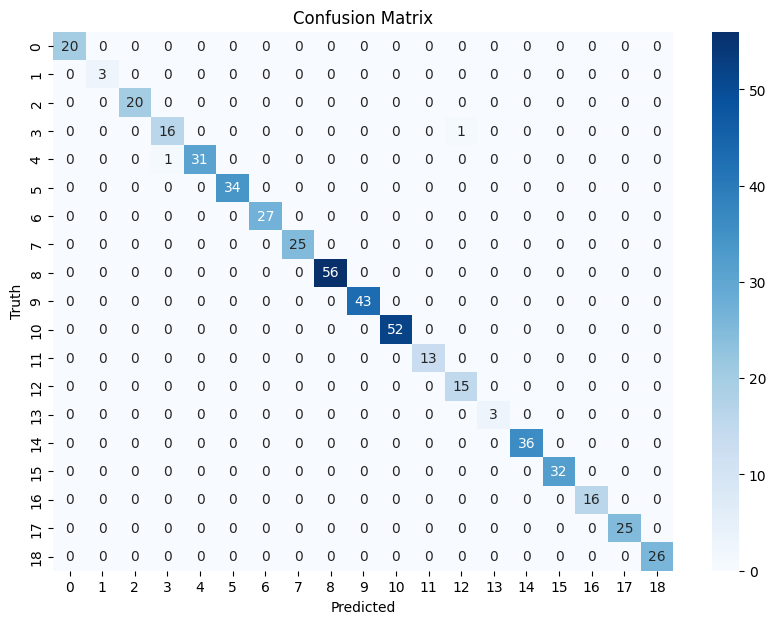

In [48]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Convert y_test from one-hot encoding to integer class labels (if needed)
y_test_labels = np.argmax(y_test, axis=-1)  # Convert one-hot encoded y_test to class labels

# Predict class labels from your CNN model
y_pred = np.argmax(model.predict(X_test), axis=-1)

# Create confusion matrix
cm = confusion_matrix(y_test_labels, y_pred)

# Plot confusion matrix using seaborn
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.title('Confusion Matrix')
plt.show()

In [49]:
#Save class dictionary
import json
# Load the model
from tensorflow.keras.models import load_model
model = load_model('cnn_model_DL_3.h5')
with open("class_dictionary.json", "r") as f:
    class_dict = json.load(f)
reverse_class_dict = {v: k for k, v in class_dict.items()}  # Reverse mapping
print("Reverse Class Dict:", reverse_class_dict)


Reverse Class Dict: {0: 'abhinav', 1: 'Algassimou DIALLO', 2: 'gerid', 3: 'hadi', 4: 'hasham', 5: 'hassan', 6: 'Haxhiu Arion', 7: 'ismail', 8: 'Juliana', 9: 'mellisa', 10: 'Nabila', 11: 'nestor', 12: 'Tuan Anh NGUYEN', 13: 'Tuan HOANG', 14: 'ubaid', 15: 'usman', 16: 'yousef', 17: 'zahid', 18: 'zeev'}


#### 2.1.16. predict class image faces 
To avoid to run again above code we split code here into small parts for predict and this code already explain above so dont confuse 

In [50]:
import cv2
import os
import shutil  # For deleting folders

def count_and_save_faces(class_img_path, output_faces_folder):
    """Detect faces in a class image, save them to a folder, and return the count."""
    
    # Load the pre-trained face detector (Haar cascade)
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

    # Read the class image
    img = cv2.imread(class_img_path)
    if img is None:
        print("Error: Could not read the class image.")
        return 0

    # Convert to grayscale for better face detection
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Detect faces
    faces = face_cascade.detectMultiScale(
        gray,
        scaleFactor=1.2,
        minNeighbors=10,
        minSize=(128, 128),
        flags=cv2.CASCADE_SCALE_IMAGE
    )

    num_faces = len(faces)
    print(f"Detected {num_faces} face(s).")

    if num_faces == 0:
        return 0

    # Ensure the output directory exists
    if  os.path.exists(output_faces_folder):
        
        for file in os.listdir(output_faces_folder):
            os.remove(os.path.join(output_faces_folder, file))
    else:
        os.makedirs(output_faces_folder)

    # Save detected faces
    for i, (x, y, w, h) in enumerate(faces):
        face_img = img[y:y+h, x:x+w]  # Crop face
        face_path = os.path.join(output_faces_folder, f"face_{i}.jpg")  # Save face
        cv2.imwrite(face_path, face_img)

    return num_faces




In [70]:
# Example usage
class_image_path = "./class_images/6.jpg" # Path to class image
output_folder = "detected_faces"      # Folder to save detected faces

num_faces = count_and_save_faces(class_image_path, output_folder)
print(f"Faces saved in '{output_folder}', Total Faces: {num_faces}")

Detected 16 face(s).
Faces saved in 'detected_faces', Total Faces: 16


In [71]:
detected_faces_path = "./detected_faces/"
face_files = os.listdir(detected_faces_path)
face_images = [cv2.imread(os.path.join(detected_faces_path, f)) for f in face_files]


In [72]:
len(face_images)

16

In [73]:
X_class, y_class = [], []
image_size=128
for f_image in face_images:
    
    scalled_raw_img = cv2.resize(f_image, (image_size, image_size))
    X_class.append(scalled_raw_img)


In [74]:
X_class = np.array(X_class).reshape(len(X_class),image_size,image_size,3).astype(float)
print(X_class.shape)

(16, 128, 128, 3)


In [75]:
X_class=X_class/255.0
print("Shape of X",X_class.shape)

Shape of X (16, 128, 128, 3)


In [76]:

# Predict
predictions = model.predict(X_class)
print("Predicted class indices:", [np.argmax(pred) for pred in predictions])

# Identify students
identified_students = [reverse_class_dict[np.argmax(pred)] for pred in predictions]  # Use argmax for multi-class classification
# Display results
print("\nIdentified Students in Class Image:")
for i, student_name in enumerate(identified_students):
    print(f"Face {i}: {student_name}")



Predicted class indices: [15, 11, 15, 11, 18, 8, 11, 12, 11, 17, 15, 18, 6, 11, 4, 17]

Identified Students in Class Image:
Face 0: usman
Face 1: nestor
Face 2: usman
Face 3: nestor
Face 4: zeev
Face 5: Juliana
Face 6: nestor
Face 7: Tuan Anh NGUYEN
Face 8: nestor
Face 9: zahid
Face 10: usman
Face 11: zeev
Face 12: Haxhiu Arion
Face 13: nestor
Face 14: hasham
Face 15: zahid


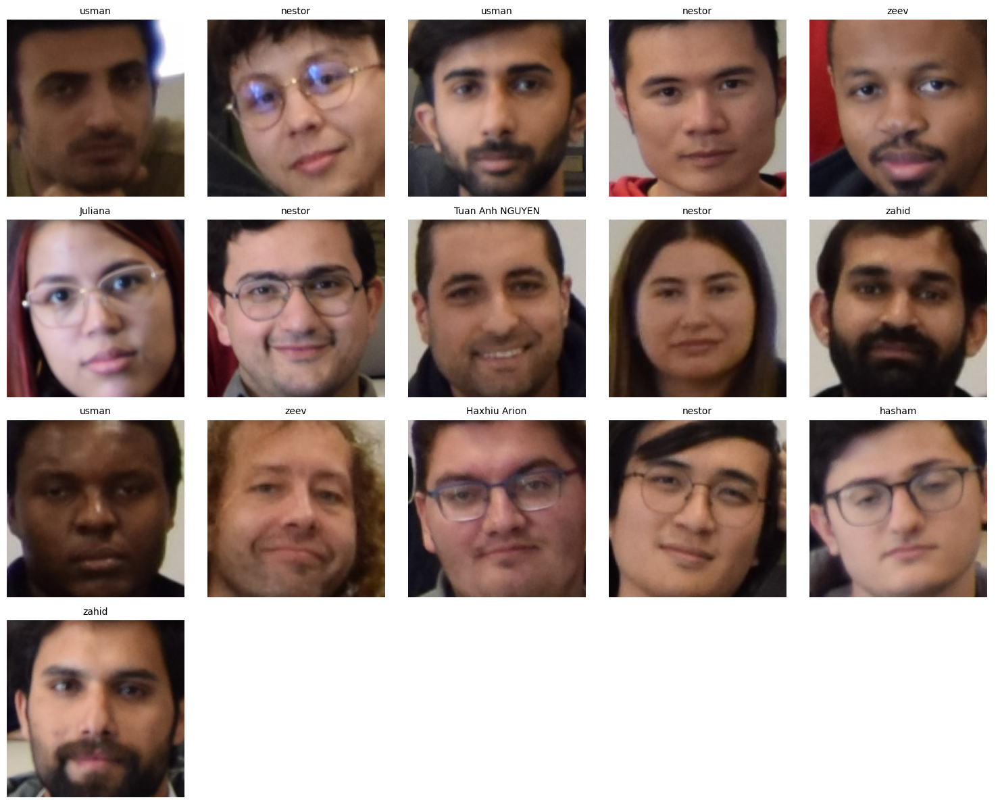

In [77]:
import matplotlib.pyplot as plt
import math

# Set up grid dimensions
num_faces = len(face_images)
num_cols = 5  # 5 columns for a better layout
num_rows = math.ceil(num_faces / num_cols)  # Calculate required rows

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 3))

# Flatten axes array for easy indexing
axes = axes.flatten()

for i, ax in enumerate(axes):
    if i < num_faces:
        ax.imshow(cv2.cvtColor(face_images[i], cv2.COLOR_BGR2RGB))
        ax.set_title(identified_students[i], fontsize=10)
        ax.axis("off")
    else:
        ax.axis("off")  # Hide extra empty subplots

plt.tight_layout()
plt.show()


# 3. Now we are going to apply top 4 pretrain model step by step 
## Reference : https://www.analyticsvidhya.com/blog/2020/08/top-4-pre-trained-models-for-image-classification-with-python-code/

## Steps : 
### 1. Load the data from the folder like all images same for all model 
### 2. Then apply **VGG16** model -> `fit` -> `save` -> `predict`
### 3. Then apply **InceptionV3** model -> `fit` -> `save` -> `predict`
### 4. Then apply **ResNet50** model -> `fit` -> `save` -> `predict`
### 5. Then apply **EfficientNetB0** model -> `fit` -> `save` -> `predict`

## 3.1. Load the data from the folder like all images same for all model 

In [ ]:
path_to_all_data_copy_croppedc2='./realdataset_copy/croppedc1/'

import cv2
img_size=128
class_dict=display_class_directory(display_each_folder_image_count(display_folder_names(path_to_all_data_copy_croppedc2)))


In [ ]:
class_dict

{'abhinav': 0,
 'Algassimou DIALLO': 1,
 'gerid': 2,
 'hadi': 3,
 'hasham': 4,
 'hassan': 5,
 'Haxhiu Arion': 6,
 'ismail': 7,
 'Juliana': 8,
 'mellisa': 9,
 'Nabila': 10,
 'nestor': 11,
 'Tuan Anh NGUYEN': 12,
 'Tuan HOANG': 13,
 'ubaid': 14,
 'usman': 15,
 'yousef': 16,
 'zahid': 17,
 'zeev': 18}

In [ ]:
X, y = prepare_training_data(display_folder_names(path_to_all_data_copy_croppedc2), class_dict, img_size)


2472


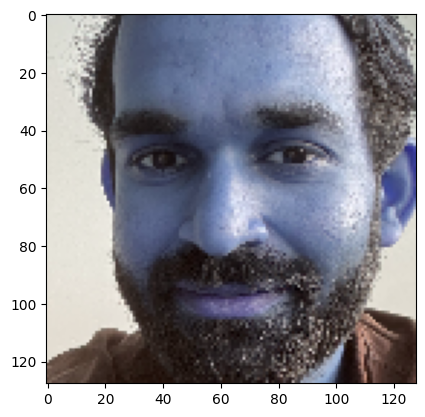

In [ ]:
import matplotlib.pyplot as plt
print(len(X))
plt.imshow(X[100])
plt.show()

In [ ]:
import numpy as np
from tensorflow.keras.utils import to_categorical
# from tensorflow.image import resize

def re_shape_X_Y1(X, y, n_classes, img_size):
    # Convert elements to NumPy arrays and resize if needed
    # X_resized = [cv2.resize(np.array(img), (img_size, img_size)) for img in X]
    # X = np.array(X_resized, dtype='float32').reshape(len(X), img_size, img_size, 3)
    X=np.array(X).reshape(len(X), img_size, img_size, 3).astype('float32')

    y = np.array(y, dtype='int32')  # Ensure integer labels
    y_category = to_categorical(y, n_classes)  # One-hot encode

    print("Shape of X:", X.shape)
    print("Shape of y:", y.shape)
    print("Shape of y_category:", y_category.shape)
    return X, y_category

In [ ]:
n_classes = len(class_dict)  # Define the number of classes
print(X[0].shape)
X_reshape, y_category = re_shape_X_Y1(X, y, n_classes,img_size)

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_reshape, y_category, test_size=0.2, random_state=42)



(128, 128, 3)
Shape of X: (2472, 128, 128, 3)
Shape of y: (2472,)
Shape of y_category: (2472, 19)


In [ ]:
X[0]


array([[[134, 133, 133],
        [138, 136, 141],
        [186, 186, 186],
        ...,
        [ 30,  29,  33],
        [ 23,  26,  31],
        [ 37,  32,  47]],

       [[144, 145, 149],
        [151, 154, 158],
        [113, 114, 118],
        ...,
        [ 31,  30,  34],
        [ 36,  35,  38],
        [171, 179, 186]],

       [[129, 123, 128],
        [100, 103, 108],
        [ 51,  46,  51],
        ...,
        [ 34,  30,  35],
        [ 22,  18,  29],
        [ 30,  31,  35]],

       ...,

       [[102,  77,  73],
        [119,  89,  84],
        [151, 113, 108],
        ...,
        [ 58,  47,  47],
        [ 39,  28,  28],
        [ 31,  18,  16]],

       [[ 97,  72,  67],
        [114,  84,  80],
        [129,  95,  89],
        ...,
        [ 63,  53,  53],
        [ 61,  51,  51],
        [ 49,  37,  36]],

       [[100,  75,  73],
        [115,  84,  81],
        [132,  99,  90],
        ...,
        [ 59,  49,  49],
        [ 59,  47,  47],
        [ 53,  41,  41]]

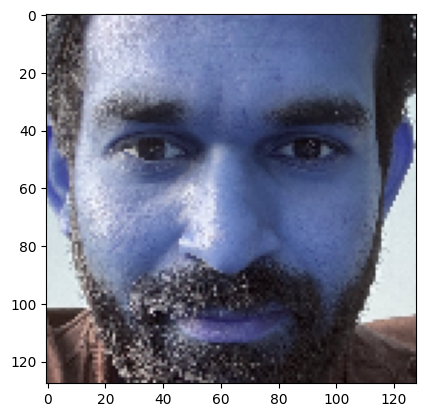

In [ ]:

plt.imshow(X[0])

In [ ]:
# 
X_train /= 255
X_test /= 255
X_train.shape, X_test.shape

((1977, 128, 128, 3), (495, 128, 128, 3))

## 3.2. Apply **VGG16** model -> `fit` -> `save` -> `predict`

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras import layers, models
import tensorflow as tf

# Load VGG16 without top layers
base_model = VGG16(input_shape=(img_size, img_size, 3), include_top=False, weights='imagenet')

# Freeze base model layers
for layer in base_model.layers:
    layer.trainable = False

# Add custom classifier
x = layers.Flatten()(base_model.output)
x = layers.Dense(512, activation='relu')(x)
x = layers.Dropout(0.5)(x)
x = layers.Dense(n_classes, activation='softmax')(x)  # 19 classes

# Define final model
model_vgg16 = tf.keras.models.Model(base_model.input, x)

# Compile the model
model_vgg16.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001),
              loss='categorical_crossentropy',  # Since it's multi-class classification
              metrics=['accuracy'])


In [ ]:

# Print model summary
# model_vgg16.summary()

# Train the model
history = model_vgg16.fit(X_train, y_train,
                    validation_data=(X_test, y_test),
                    epochs=15,
                    batch_size=16)


Epoch 1/15
124/124 [==============================] - 13s 80ms/step - loss: 1.6263 - accuracy: 0.5620 - val_loss: 0.6648 - val_accuracy: 0.8606
Epoch 2/15
124/124 [==============================] - 6s 51ms/step - loss: 0.5330 - accuracy: 0.8816 - val_loss: 0.2918 - val_accuracy: 0.9455
Epoch 3/15
124/124 [==============================] - 6s 52ms/step - loss: 0.2446 - accuracy: 0.9509 - val_loss: 0.1617 - val_accuracy: 0.9717
Epoch 4/15
124/124 [==============================] - 6s 52ms/step - loss: 0.1498 - accuracy: 0.9671 - val_loss: 0.1097 - val_accuracy: 0.9737
Epoch 5/15
124/124 [==============================] - 6s 52ms/step - loss: 0.0942 - accuracy: 0.9838 - val_loss: 0.0639 - val_accuracy: 0.9879
Epoch 6/15
124/124 [==============================] - 6s 52ms/step - loss: 0.0521 - accuracy: 0.9934 - val_loss: 0.0735 - val_accuracy: 0.9859
Epoch 7/15
124/124 [==============================] - 6s 52ms/step - loss: 0.0410 - accuracy: 0.9949 - val_loss: 0.0419 - val_accuracy: 0.987

In [ ]:
# Save the trained CNN model
model_vgg16.save('model_vgg16.h5')

# Save the class dictionary
import json
with open("class_dictionary.json", "w") as f:
    f.write(json.dumps(class_dict))

### 3.2.1. Below is an overview of the functions that we will use for class image prediction of faces :

### Functions Overview

1. **`load_model_and_class_dict(model_path, class_dict_path)`**
   - Loads the pre-trained deep learning model.
   - Reads the class dictionary mapping student names to class indices.

2. **`count_and_save_faces(class_img_path, output_faces_folder, image_size=128)`**
   - Detects faces in the given image using OpenCV’s Haar cascade.
   - Saves the detected faces as separate images in a specified folder.

3. **`preprocess_faces(face_folder, image_size=128)`**
   - Loads, resizes, and normalizes face images to prepare them for model prediction.

4. **`predict_faces(model, X_class, reverse_class_dict)`**
   - Predicts the identities of detected faces using the trained model.
   - Converts model outputs into human-readable names using the class dictionary.

5. **`save_attendance(identified_students, class_dict_path, model_name)`**
   - Saves attendance records in a CSV file.
   - Marks students as "Present" if identified in the image.

6. **`display_faces(face_images, identified_students, num_cols=5)`**
   - Displays the detected faces alongside their predicted names using Matplotlib.

7. **`main(model_path, class_dict_path, class_image_path, output_folder, image_size=128)`**
   - Executes the complete face recognition and attendance marking process.
   - Calls all the above functions sequentially.

### Usage
- Provide a trained model and a class dictionary.
- Capture an image of a classroom.
- Run the pipeline to detect faces, predict student identities, and save attendance.
- View the detected faces with labels.




In [1]:
import os
import cv2
import json
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
from tensorflow.keras.models import load_model

def load_model_and_class_dict(model_path, class_dict_path):
    """Load the trained model and class dictionary."""
    model = load_model(model_path)
    with open(class_dict_path, "r") as f:
        class_dict = json.load(f)
    reverse_class_dict = {v: k for k, v in class_dict.items()}
    return model, reverse_class_dict

def count_and_save_faces(class_img_path, output_faces_folder, image_size=128):
    """Detect faces in an image and save them in a folder."""
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")
    img = cv2.imread(class_img_path)
    if img is None:
        print("Error: Could not read the class image.")
        return 0
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.2, minNeighbors=10, minSize=(32, 32), flags=cv2.CASCADE_SCALE_IMAGE)
    num_faces = len(faces)
    print(f"Detected {num_faces} face(s).")
    if num_faces == 0:
        return 0
    if os.path.exists(output_faces_folder):
        for file in os.listdir(output_faces_folder):
            os.remove(os.path.join(output_faces_folder, file))
    else:
        os.makedirs(output_faces_folder)
    for i, (x, y, w, h) in enumerate(faces):
        face_img = img[y:y+h, x:x+w]
        face_path = os.path.join(output_faces_folder, f"face_{i}.jpg")
        cv2.imwrite(face_path, face_img)
    return num_faces

def preprocess_faces(face_folder, image_size=128):
    """Load, resize, and normalize face images for prediction."""
    face_files = os.listdir(face_folder)
    face_images = [cv2.imread(os.path.join(face_folder, f)) for f in face_files]
    X_class = [cv2.resize(img, (image_size, image_size)) for img in face_images if img is not None]
    X_class = np.array(X_class).reshape(len(X_class), image_size, image_size, 3).astype(float) / 255.0
    return X_class, face_images

def predict_faces(model, X_class, reverse_class_dict):
    """Predict face identities using the trained model."""
    predictions = model.predict(X_class)
    identified_students = [reverse_class_dict[np.argmax(pred)] for pred in predictions]
    return identified_students
# save attendance
def save_attendance(identified_students, class_dict_path, model_name):
    """Save the attendance sheet as a CSV file."""
    with open(class_dict_path, "r") as f:
        class_dict = json.load(f)
    all_students = list(class_dict.keys())
    
    attendance_data = {"Student Name": all_students, "Attendance": ["Present" if name in identified_students else "Absent" for name in all_students]}
    df = pd.DataFrame(attendance_data)
    file_name = f"attendance_{model_name}.csv"
    df.to_csv(file_name, index=False)
    print(f"Attendance sheet saved as {file_name}")

def display_faces(face_images, identified_students, num_cols=5):
    """Display detected faces with predicted names."""
    num_faces = len(face_images)
    num_rows = math.ceil(num_faces / num_cols)
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 3))
    axes = axes.flatten()
    for i, ax in enumerate(axes):
        if i < num_faces:
            ax.imshow(cv2.cvtColor(face_images[i], cv2.COLOR_BGR2RGB))
            ax.set_title(identified_students[i], fontsize=10)
            ax.axis("off")
        else:
            ax.axis("off")
    plt.tight_layout()
    plt.show()

def main(model_path, class_dict_path, class_image_path, output_folder, image_size=128):
    """Main function to execute the pipeline."""
    model, reverse_class_dict = load_model_and_class_dict(model_path, class_dict_path)
    model_name = os.path.basename(model_path).split('.')[0]  # Extract model name
    plt.imshow(cv2.imread(class_image_path))
    num_faces = count_and_save_faces(class_image_path, output_folder, image_size)
    if num_faces == 0:
        print("No faces detected.")
        return
    X_class, face_images = preprocess_faces(output_folder, image_size)
    identified_students = predict_faces(model, X_class, reverse_class_dict)
    print("\nIdentified Students:")
    for i, student_name in enumerate(identified_students):
        print(f"Face {i}: {student_name}")
    save_attendance(identified_students, class_dict_path, model_name)
    display_faces(face_images, identified_students)


Detected 3 face(s).

Identified Students:
Face 0: mellisa
Face 1: yousef
Face 2: hadi
Attendance sheet saved as attendance_model_vgg16.csv


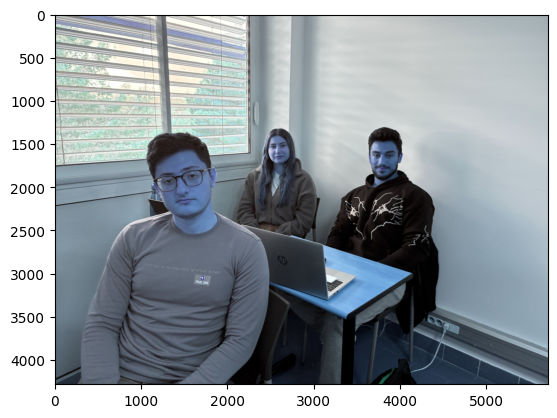

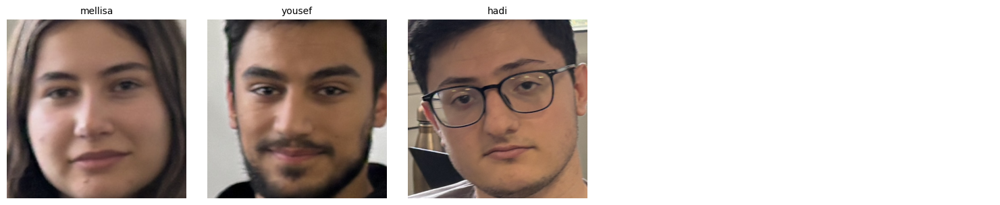

In [2]:
#  Usage above methods for predict 
model_path = "model_vgg16.h5"
class_dict_path = "class_dictionary.json"
class_image_path = "./class_images/15.jpg"
output_folder = "detected_faces"
# save student attendance in csv file
main(model_path, class_dict_path, class_image_path, output_folder)

## 3.3. Apply **InceptionV3** model -> `fit` -> `save` -> `predict`

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras import layers, models, optimizers
import tensorflow as tf

# Load the pre-trained InceptionV3 model
base_model = InceptionV3(
    input_shape=(img_size, img_size, 3),
    include_top=False,
    weights='imagenet'
)

# Freeze the convolutional base
for layer in base_model.layers:
    layer.trainable = False

# Add new fully connected layers
x = layers.Flatten()(base_model.output)
x = layers.Dense(2048, activation='relu')(x)
x = layers.BatchNormalization()(x)  # Normalize activations
x = layers.Dropout(0.3)(x)

x = layers.Dense(1024, activation='relu')(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.3)(x)

x = layers.Dense(512, activation='relu')(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.2)(x)

# Output layer for multi-class classification
x = layers.Dense(n_classes, activation='softmax')(x)

# Create the model
model_InceptionV3 = models.Model(base_model.input, x)

# Compile with Adam optimizer for better optimization
model_InceptionV3.compile(
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


In [ ]:
history = model_InceptionV3.fit(X_train, y_train,
                    validation_data=(X_test, y_test),
                    epochs=15,
                    batch_size=16)

Epoch 1/15
124/124 [==============================] - 10s 44ms/step - loss: 1.3606 - accuracy: 0.6308 - val_loss: 0.5914 - val_accuracy: 0.8404
Epoch 2/15
124/124 [==============================] - 4s 32ms/step - loss: 0.4513 - accuracy: 0.8690 - val_loss: 0.2714 - val_accuracy: 0.9172
Epoch 3/15
124/124 [==============================] - 4s 32ms/step - loss: 0.2593 - accuracy: 0.9358 - val_loss: 0.2047 - val_accuracy: 0.9374
Epoch 4/15
124/124 [==============================] - 4s 32ms/step - loss: 0.1766 - accuracy: 0.9514 - val_loss: 0.1825 - val_accuracy: 0.9374
Epoch 5/15
124/124 [==============================] - 4s 32ms/step - loss: 0.1192 - accuracy: 0.9671 - val_loss: 0.1665 - val_accuracy: 0.9535
Epoch 6/15
124/124 [==============================] - 4s 31ms/step - loss: 0.0875 - accuracy: 0.9793 - val_loss: 0.1427 - val_accuracy: 0.9616
Epoch 7/15
124/124 [==============================] - 4s 32ms/step - loss: 0.0577 - accuracy: 0.9894 - val_loss: 0.1465 - val_accuracy: 0.965

In [ ]:
# Save the trained CNN model
model_InceptionV3.save('model_InceptionV3.h5')

# Save the class dictionary
import json
with open("class_dictionary.json", "w") as f:
    f.write(json.dumps(class_dict))

Detected 3 face(s).

Identified Students:
Face 0: mellisa
Face 1: hadi
Face 2: hassan


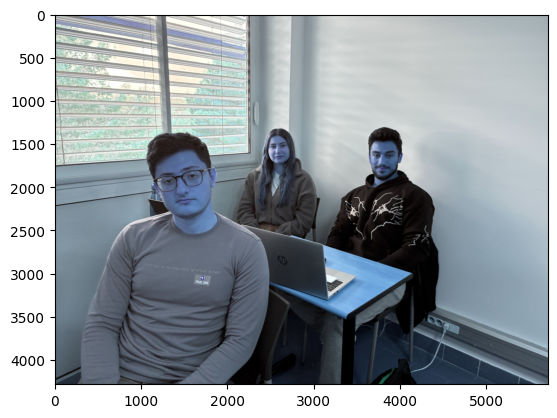

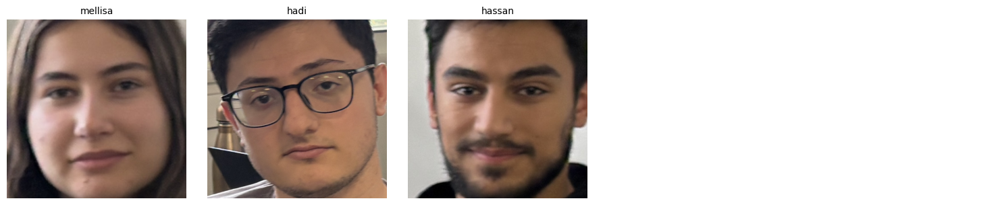

In [ ]:
# Example Usage
model_path = "model_InceptionV3.h5"
class_dict_path = "class_dictionary.json"
class_image_path = "./class_images/15.jpg"
output_folder = "detected_faces"

main(model_path, class_dict_path, class_image_path, output_folder)

## 3.3. Apply **ResNet50** model -> `fit` -> `save` -> `predict`

In [ ]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models, optimizers
import tensorflow as tf

# Load the pre-trained ResNet50 model
base_model = ResNet50(input_shape=(img_size, img_size, 3), include_top=False, weights="imagenet")

# Freeze the convolutional base
for layer in base_model.layers:
    layer.trainable = False

# Build the classification head
x = layers.GlobalAveragePooling2D()(base_model.output)  # Better than Flatten for ResNet
# x = layers.Dense(2048, activation='relu')(x)
# x = layers.BatchNormalization()(x)
# x = layers.Dropout(0.3)(x)

# x = layers.Dense(1024, activation='relu')(x)
# x = layers.BatchNormalization()(x)
# x = layers.Dropout(0.3)(x)

x = layers.Dense(1024, activation='relu')(x)
x = layers.BatchNormalization()(x)
x = layers.Dropout(0.5)(x)

# Output layer for multi-class classification
x = layers.Dense(n_classes, activation='softmax')(x)

# Create the model
model_ResNet50 = models.Model(base_model.input, x)

# Compile with Adam optimizer for better optimization
model_ResNet50.compile(
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


In [ ]:
history = model_ResNet50.fit(X_train, y_train,
                    validation_data=(X_test, y_test),
                    epochs=20,
                    batch_size=32)

Epoch 1/20
62/62 [==============================] - 5s 66ms/step - loss: 0.6634 - accuracy: 0.8528 - val_loss: 0.8868 - val_accuracy: 0.7434
Epoch 2/20
62/62 [==============================] - 3s 53ms/step - loss: 0.6549 - accuracy: 0.8508 - val_loss: 0.8837 - val_accuracy: 0.7354
Epoch 3/20
62/62 [==============================] - 3s 54ms/step - loss: 0.6521 - accuracy: 0.8523 - val_loss: 0.8736 - val_accuracy: 0.7515
Epoch 4/20
62/62 [==============================] - 3s 53ms/step - loss: 0.6263 - accuracy: 0.8543 - val_loss: 0.8502 - val_accuracy: 0.7253
Epoch 5/20
62/62 [==============================] - 3s 53ms/step - loss: 0.6213 - accuracy: 0.8634 - val_loss: 0.8701 - val_accuracy: 0.7111
Epoch 6/20
62/62 [==============================] - 3s 53ms/step - loss: 0.5877 - accuracy: 0.8741 - val_loss: 0.8212 - val_accuracy: 0.7414
Epoch 7/20
62/62 [==============================] - 4s 57ms/step - loss: 0.5747 - accuracy: 0.8746 - val_loss: 0.8075 - val_accuracy: 0.7737
Epoch 8/20
62

Detected 15 face(s).

Identified Students:
Face 0: Juliana
Face 1: abhinav
Face 2: hasham
Face 3: yousef
Face 4: hassan
Face 5: hassan
Face 6: Juliana
Face 7: nestor
Face 8: hasham
Face 9: hassan
Face 10: Tuan HOANG
Face 11: Tuan Anh NGUYEN
Face 12: hadi
Face 13: usman
Face 14: yousef


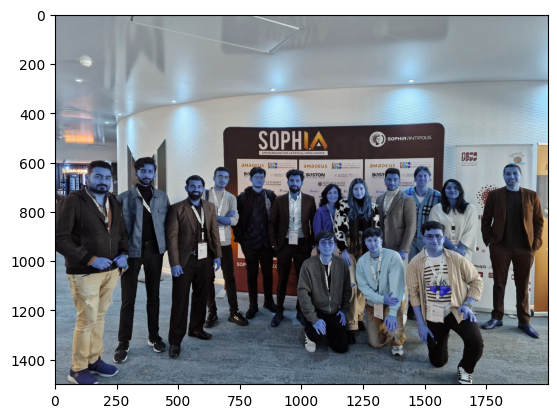

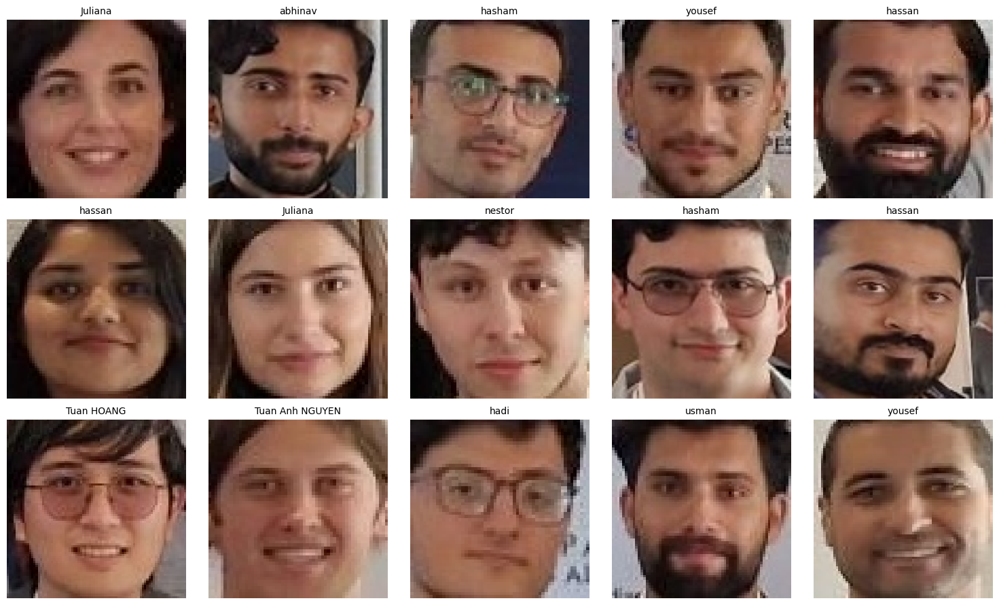

In [ ]:

# Example Usage
model_path = "model_ResNet50.h5"
class_dict_path = "class_dictionary.json"
class_image_path = "./class_images/4.jpg"
output_folder = "detected_faces"

main(model_path, class_dict_path, class_image_path, output_folder)

## 3.4. Apply **EfficientNetB0** model -> `fit` -> `save` -> `predict`

In [ ]:
# !pip install -U efficientnet

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers
import efficientnet.tfkeras as efn

base_model = efn.EfficientNetB0(
    input_shape=(img_size, img_size, 3),
    include_top=False,
    weights='imagenet'
)

for layer in base_model.layers:
    layer.trainable = False

x = base_model.output
x = layers.Flatten()(x)
x = layers.Dense(1024, activation="relu")(x)
x = layers.Dropout(0.5)(x)

# Add a final sigmoid layer with 1 node for classification output
predictions = layers.Dense(n_classes, activation="sigmoid")(x)

model_EfficientNetB0 = models.Model(inputs=base_model.input, outputs=predictions)

# Compile with Adam optimizer for better optimization
model_EfficientNetB0.compile(
    optimizer=optimizers.Adam(learning_rate=0.0001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


16818176/16804768 [==============================] - 28s 2us/step


In [ ]:
history = model_EfficientNetB0.fit(X_train, y_train,
                    validation_data=(X_test, y_test),
                    epochs=20,
                    batch_size=32)

model_EfficientNetB0.save('model_EfficientNetB0.h5')

Epoch 1/20
62/62 [==============================] - 11s 81ms/step - loss: 0.9063 - accuracy: 0.7375 - val_loss: 0.1083 - val_accuracy: 0.9798
Epoch 2/20
62/62 [==============================] - 3s 45ms/step - loss: 0.1097 - accuracy: 0.9727 - val_loss: 0.0576 - val_accuracy: 0.9859
Epoch 3/20
62/62 [==============================] - 3s 45ms/step - loss: 0.0602 - accuracy: 0.9879 - val_loss: 0.0295 - val_accuracy: 0.9939
Epoch 4/20
62/62 [==============================] - 3s 44ms/step - loss: 0.0454 - accuracy: 0.9863 - val_loss: 0.0444 - val_accuracy: 0.9879
Epoch 5/20
62/62 [==============================] - 3s 42ms/step - loss: 0.0300 - accuracy: 0.9924 - val_loss: 0.0331 - val_accuracy: 0.9879
Epoch 6/20
62/62 [==============================] - 3s 42ms/step - loss: 0.0276 - accuracy: 0.9934 - val_loss: 0.0243 - val_accuracy: 0.9939
Epoch 7/20
62/62 [==============================] - 3s 42ms/step - loss: 0.0181 - accuracy: 0.9954 - val_loss: 0.0209 - val_accuracy: 0.9919
Epoch 8/20
6

Detected 3 face(s).

Identified Students:
Face 0: mellisa
Face 1: yousef
Face 2: hadi


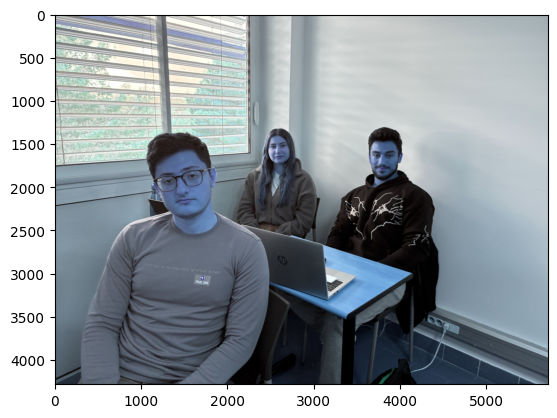

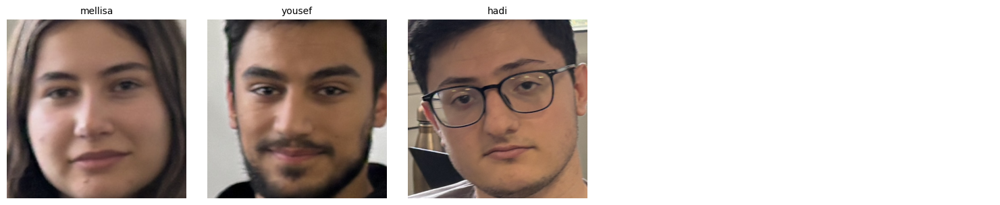

In [ ]:

#  Example Usage
model_path = "model_EfficientNetB0.h5"
class_dict_path = "class_dictionary.json"
class_image_path = "./class_images/15.jpg"
output_folder = "detected_faces"

main(model_path, class_dict_path, class_image_path, output_folder)

## 3.5. Conclution for Deep Learning

| Model          | Train Loss | Train Accuracy | Val Loss | Val Accuracy |
|---------------|------------|---------------|---------|-------------|
| **VGG16**         | 0.0033     | 1.0000        | 0.0206  | 0.9919      |
| **InceptionV3**   | 0.0315     | 0.9939        | 0.1339  | 0.9616      |
| **ResNet50**      | 0.4501     | 0.9079        | 0.5955  | 0.8667      |
| **EfficientNetB0**| 0.0102     | 0.9965        | 0.0235  | 0.9919      |

### **Model Selection for Image Classification**
- **VGG16** and **EfficientNetB0** both show excellent performance with validation accuracy of **99.19%**, making them strong choices.
- **InceptionV3** has a slightly lower validation accuracy (**96.16%**) but might be useful if the dataset is small due to its efficient architecture.
- **ResNet50** has the lowest accuracy (**86.67%**), making it a weaker choice for this dataset.
- **EfficientNetB0** offers a balance of high accuracy and efficiency, making it a recommended choice for real-world applications.

The above results are correct in this case, as the faces were identified accurately in VGG16 model. However, these images were taken with an iPhone and are clear. If the images are blurry or not clear, especially in a classroom setting, the model may not produce the expected output.  


# 4. Recognize the gender of each face
## Download gender-classification-dataset 
## Credit goes to Kaggle for this dataset and implementation for smooth gender detection
### Reference : https://www.kaggle.com/datasets/cashutosh/gender-classification-dataset/code
### Reference : https://www.kaggle.com/code/ubaidurrehman404/gender-classification-w-keras/edit
The data set is of cropped images of male and female . It is split into training and validation directory. Training contains ~23,000 images of each class and validation directory contains ~5,500 images of each class.

## 4.1. Check GPU 

In [10]:
from tensorflow.python.client import device_lib 
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 555487828552084150
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 3672113152
locality {
  bus_id: 1
  links {
  }
}
incarnation: 13373582423781010679
physical_device_desc: "device: 0, name: NVIDIA GeForce RTX 3050 6GB Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.6"
xla_global_id: 416903419
]


## 4.2. Get Train, Validation and Test Dataset
We are using the ImageDataGenerator to get images and labels to obtain train, validation, test from directory with some preprocessing on images.

In [11]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
#https://www.kaggle.com/code/ubaidurrehman404/gender-classification-w-keras/edit
train_dir = "./content/Training"
val_dir = "./content/Validation"
#https://www.kaggle.com/code/serhanayberkkl/man-woman-gender
train_gen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True

)

test_gen = ImageDataGenerator(rescale=1./255)

## 4.3. Values of datasets

In [12]:
train_generator = train_gen.flow_from_directory(
    train_dir,
    target_size=(32, 32),
    batch_size=512,
    class_mode="binary",
    subset="training"
)

val_generator = train_gen.flow_from_directory(
    train_dir,
    target_size=(32, 32),
    batch_size=512,
    class_mode="binary",
    subset="validation"
)

test_generator = test_gen.flow_from_directory(
    val_dir,
    target_size=(32, 32),
    batch_size=512,
    class_mode="binary",
    shuffle=False
)

Found 37608 images belonging to 2 classes.
Found 9401 images belonging to 2 classes.
Found 11649 images belonging to 2 classes.


In [13]:
train_generator.class_indices

{'female': 0, 'male': 1}

In [14]:
img, label = next(train_generator)

## 4.4. Some Visualization

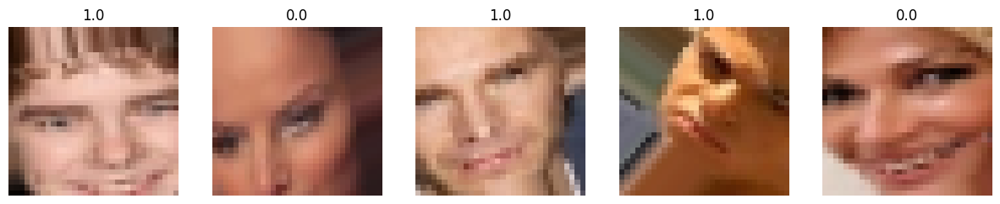

In [15]:
import matplotlib.pyplot as plt


fig, axes = plt.subplots(1, 5, figsize=(15,5))
for i in range(5):
    axes[i].imshow(img[i])
    axes[i].axis('off')
    axes[i].set_title(label[i])
plt.show()

## 4.5. CNN Modelling w/ Keras¶ , Import 

Hyperparameter Tuning it takes so much time to fit model, so thats why we cannot create code for it 

In [16]:
from keras.layers import Flatten, Dense, Conv2D, MaxPooling2D, Dropout, BatchNormalization
from keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from keras.callbacks import EarlyStopping
from keras.regularizers import l1_l2

!pip install keras-tuner -q
from kerastuner.tuners import RandomSearch

from keras.models import load_model

In [ ]:
## apply cnn
model = Sequential()

model.add(Conv2D(filters=32,
                     kernel_size=(3, 3),
                     activation='relu',
                     input_shape=(32, 32, 3),
                     kernel_regularizer = l1_l2(0.0001, 0.0001)))
model.add(MaxPooling2D(pool_size=(2, 2)))


model.add(Conv2D(filters=64,
                      kernel_size=(3, 3),
                      activation='relu',
                      kernel_regularizer = l1_l2(0.0001, 0.0001)))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2), padding="same"))
model.add(Dropout(0.25))

model.add(Conv2D(filters=128,
                      kernel_size=(3, 3),
                      activation='relu',
                      kernel_regularizer = l1_l2(0.0001, 0.0001)))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2), padding="same"))
model.add(Dropout(0.25))



model.add(Flatten())
model.add(Dense(units=128,
                   activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(1, activation='sigmoid'))
model.compile(optimizer=Adam(0.0001),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])

In [ ]:
## fit the model
result = model.fit(train_generator, epochs=30, validation_data=val_generator)

Epoch 1/30
74/74 [==============================] - 366s 5s/step - loss: 1.1740 - accuracy: 0.5834 - val_loss: 0.9858 - val_accuracy: 0.5913
Epoch 2/30
74/74 [==============================] - 91s 1s/step - loss: 0.9780 - accuracy: 0.6336 - val_loss: 0.9516 - val_accuracy: 0.6743
Epoch 3/30
74/74 [==============================] - 109s 1s/step - loss: 0.9107 - accuracy: 0.6702 - val_loss: 0.9042 - val_accuracy: 0.7056
Epoch 4/30
74/74 [==============================] - 138s 2s/step - loss: 0.8759 - accuracy: 0.6897 - val_loss: 0.8658 - val_accuracy: 0.7012
Epoch 5/30
74/74 [==============================] - 65s 877ms/step - loss: 0.8439 - accuracy: 0.7100 - val_loss: 0.8274 - val_accuracy: 0.7197
Epoch 6/30
74/74 [==============================] - 38s 507ms/step - loss: 0.8123 - accuracy: 0.7289 - val_loss: 0.8019 - val_accuracy: 0.7341
Epoch 7/30
74/74 [==============================] - 37s 479ms/step - loss: 0.7893 - accuracy: 0.7403 - val_loss: 0.7450 - val_accuracy: 0.7699
Epoch 8/

## 4.6. Accuracy and Loss plot

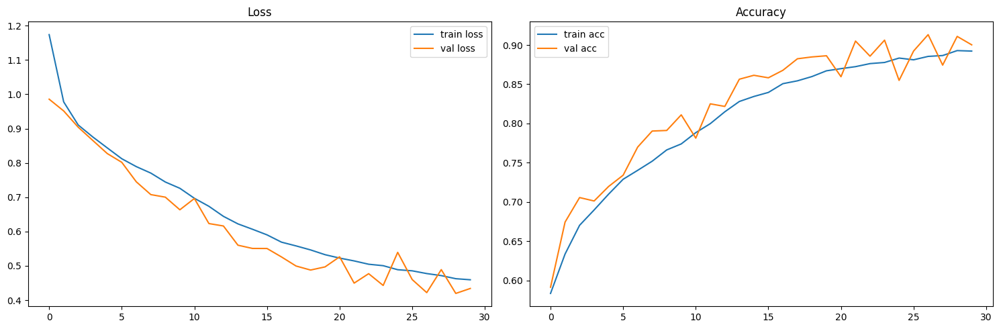

In [ ]:
#display loss accuracy plot
fig, ax = plt.subplots(1, 2, figsize=(15,5))
ax[0].plot(result.history['loss'], label='train loss')
ax[0].plot(result.history['val_loss'], label='val loss')
ax[0].legend()
ax[0].set_title('Loss')

ax[1].plot(result.history['accuracy'], label='train acc')
ax[1].plot(result.history['val_accuracy'], label='val acc')
ax[1].legend()
ax[1].set_title('Accuracy')

plt.tight_layout()
plt.show()

In [ ]:
#save model
model.save('/content/CNN_gender_model.h5')

In [21]:
best_model = load_model('/content/CNN_gender_model.h5')

In [22]:
loss, accuracy = best_model.evaluate(test_generator)

print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy}")

23/23 [==============================] - 216s 10s/step - loss: 0.3853 - accuracy: 0.9209
Test Loss: 0.3852682113647461
Test Accuracy: 0.9208515882492065


## 4.7. Confusion Matrix

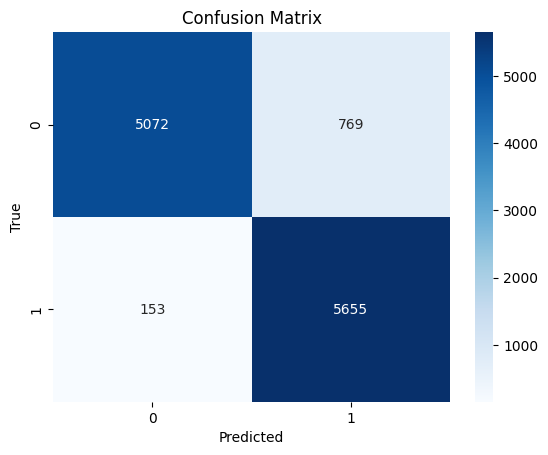

              precision    recall  f1-score   support

      Female       0.97      0.87      0.92      5841
        Male       0.88      0.97      0.92      5808

    accuracy                           0.92     11649
   macro avg       0.93      0.92      0.92     11649
weighted avg       0.93      0.92      0.92     11649



In [23]:
import seaborn as sns

y_true = test_generator.labels
y_pred = (best_model.predict(test_generator) > 0.5).astype("int32").flatten()
"""
sorted_indices = np.argsort(test_generator.filenames)
y_true = y_true[sorted_indices]
y_pred = y_pred[sorted_indices]
"""
# Confusion matrix ve classification report
from sklearn.metrics import confusion_matrix, classification_report
sns.heatmap(confusion_matrix(y_true, y_pred), annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()
print(classification_report(y_true, y_pred, target_names=["Female","Male"]))


## 4.8. Create Methods for Predict Gender

In [ ]:
import numpy as np
import random
from tensorflow.keras.preprocessing import image
## methods for prediction
def predict_and_show_images(model, test_generator, num_images=5):
    plt.figure(figsize=(25, 25))
    for i in range(num_images):
        # Choose a random image
        img_path = test_generator.filepaths[random.randint(0, len(test_generator.filepaths) - 1)]
        # Load and preprocess the image
        img = image.load_img(img_path, target_size=(32, 32))
        img_array = image.img_to_array(img) / 255.0
        img_array = np.expand_dims(img_array, axis=0)
        # Make the prediction
        prediction = model.predict(img_array)
        pred_label = 'Male' if prediction[0][0] > 0.5 else 'Female'
        # Display the image with the prediction
        plt.subplot(1, num_images, i + 1)
        plt.imshow(image.load_img(img_path))
        plt.title(f"Prediction: {pred_label}")
        plt.axis("off")
    plt.show()

def predict_any_image(model, image_path):
    img = image.load_img(image_path, target_size=(32, 32))
    img_array = image.img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    prediction = model.predict(img_array)
    pred_label = 'Male' if prediction[0][0] > 0.5 else 'Female'
    plt.imshow(img)
    plt.title(f"Prediction: {pred_label}, Confidence: {prediction[0][0]: .2f}")
    plt.axis("off")
    plt.show()

## 4.9. Which class image will predict?

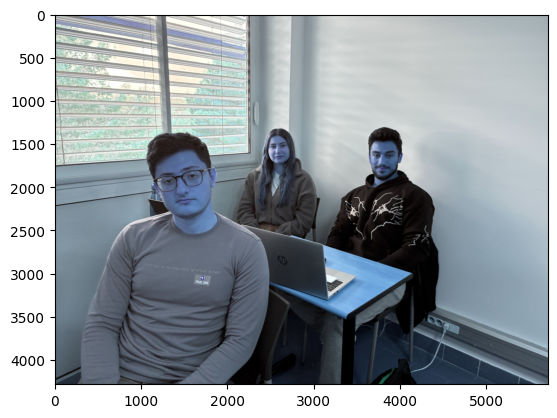

In [ ]:

class_image_path = "./class_images/15.jpg"
plt.imshow(cv2.imread(class_image_path))

## 4.10. Lets See Result:

Predicting: ./detected_faces/face_0.jpg


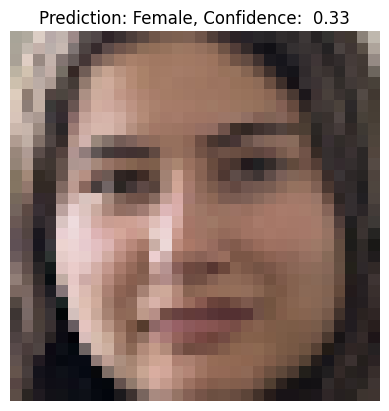

Predicting: ./detected_faces/face_1.jpg


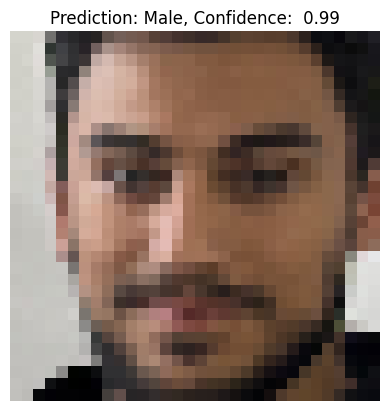

Predicting: ./detected_faces/face_2.jpg


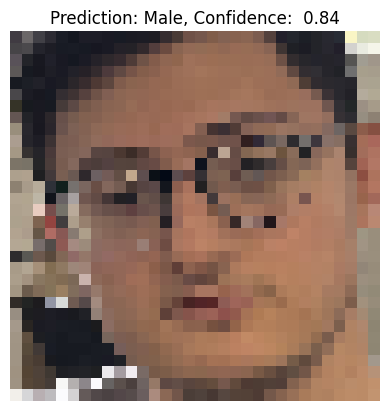

In [ ]:
import os
import cv2
from matplotlib import pyplot as plt


# Function to predict on all images in the detected_faces folder
def predict_all_images(model, folder_path="./detected_faces/"):
    # Get all image files from the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

    # Apply prediction on each image
    for img_file in image_files:
        img_path = os.path.join(folder_path, img_file)
        print(f"Predicting: {img_path}")
        predict_any_image(model, img_path)

# Run the function
predict_all_images(best_model)


In [29]:
best_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 30, 30, 32)        896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 15, 15, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 13, 13, 64)        18496     
                                                                 
 batch_normalization_2 (Batc  (None, 13, 13, 64)       256       
 hNormalization)                                                 
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 7, 7, 64)         0         
 2D)                                                             
                                                      

## 4.11. Conclution Gender Detection :  
As you can see the result are positive in term of detection of gender just because of dataset because we just dataset where we have male and female images to detect gender so at the end we get   `0.92` accuracy in traning but still need improvement for better performance.

## References

1. **Face and Eye Detection**
   - Haar cascade for face detection: [OpenCV Tutorial](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_objdetect/py_face_detection/py_face_detection.html?highlight=haar)
   - Limiting the number of detected faces: [StackOverflow](https://stackoverflow.com/questions/52288066/how-to-limit-number-of-faces-detected-by-haar-cascades)

2. **Face Detection in Video**
   - Detecting faces in video, cropping, and saving frames: [StackOverflow](https://stackoverflow.com/questions/60546695/detect-faces-in-video-crop-them-and-save-all-frames-in-the-same-order-opencv)

3. **Image Transformations**
   - Rotating an image using OpenCV: [StackOverflow](https://stackoverflow.com/questions/9041681/opencv-python-rotate-image-by-x-degrees-around-specific-point)

4. **Wavelet Transform for Feature Extraction**
   - Combining PyWavelets and OpenCV for image processing: [StackOverflow](https://stackoverflow.com/questions/24536552/how-to-combine-pywavelet-and-opencv-for-image-processing)

5. **False Positives in Face Detection**
   - Setting minNeighbours and minSize to reduce false positives: [StackOverflow](https://stackoverflow.com/questions/52288066/how-to-limit-number-of-faces-detected-by-haar-cascades)

6. **Feature Reduction and Hyperparameter Tuning**
   - Using PCA to reduce features for faster execution
   - HalvingRandomSearchCV vs GridSearchCV: [Medium Article](https://medium.com/@tom.kaminski01/halvingrandomsearchcv-vs-gridsearchcv-f1cd42f54b3b)

7. **CNN for Image Classification**
   - Learning Image Classification with CNN: [Analytics Vidhya](https://www.analyticsvidhya.com/blog/2020/02/learn-image-classification-cnn-convolutional-neural-networks-3-datasets/)

8. **Pre-trained Models for Image Classification**
   - Top 4 pre-trained models for image classification: [Analytics Vidhya](https://www.analyticsvidhya.com/blog/2020/08/top-4-pre-trained-models-for-image-classification-with-python-code/)

9. **Gender Classification**
   - Gender classification dataset: [Kaggle Dataset](https://www.kaggle.com/datasets/cashutosh/gender-classification-dataset/code)
   - Gender classification using Keras: [Kaggle Notebook](https://www.kaggle.com/code/ubaidurrehman404/gender-classification-w-keras/edit)
